##TC Download and Convertion to .png

This script downloads the SMOS / SMAP / SAR data from the Cyclobs API and converts the resulting .nc files into .jpg files.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# getting in the directory 
%ls
# insert your path
%cd /content/drive/My\ Drive/ESRIN_PhiLab/Tropical_Cyclones/data
%ls

drive/  sample_data/
/content/drive/My Drive/ESRIN_PhiLab/Tropical_Cyclones/data
best_track/                            SAR_swath_images_VH+VH+VH/
categorisation.png                     SAR_swath_images_VV+VH+VH/
classification_results/                SAR_swath_images_VV+VH+WS/
identification.png                     SAR_swath_images_VV+VV+VV/
model_comparisons_between_datasets/    SAR_swath_images_WS+sWSO+cWSO/
model.png                              SAR_swath_images_WS+WS+WS/
parametric_model/                      SAR_swath_masks/
SAR_IMAGE_DATASET_EYE_CLASSIFICATION@  SAR_swath_nc/
SAR_swath_images@                      SAR_swath_Vmax/


In [ ]:
#!pip install imgaug==0.2.6
#!pip uninstall shapely
#!pip install shapely --no-binary shapely
#!apt-get install libproj-dev proj-data proj-bin  
#!apt-get install libgeos-dev  
#!pip install cython  
#!pip install cartopy  
#!pip install geoviews
#!pip install rasterio
!pip install netcdf4
#!pip install rioxarray

     |████████████████████████████████| 4.7MB 5.4MB/s 
     |████████████████████████████████| 317kB 38.5MB/s 


In [3]:
# general import
#import bokeh.io
#bokeh.io.output_notebook()
#import geoviews as gv
#import geoviews.feature as gf
#gv.extension('bokeh','matplotlib')
import pandas as pd
import numpy as np
import xarray as xr
#import rasterio as rio
#import rioxarray # geospatial extension for xarray
import os
import matplotlib.pyplot as plt
#import cartopy.crs as ccrs
#import cartopy
from tqdm.auto import tqdm
#import netCDF4
import glob
import argparse
import cv2
from google.colab.patches import cv2_imshow
import math 
from math import radians, cos, sin, asin, sqrt
from dateutil import parser
import datetime
import sys
import cv2

General settings to be changes accordingly.

In [ ]:
# insert here category, mission and feature you want to extract
CATEGORY = "cat1" # either 1, 2, 3, 4, 5
MISSION = "smap" # either sar, smap or smos
if MISSION == "sar":
  KEY = "s1"
  FEATURE_TO_SAVE = "nrcs_detrend"
  CHANNELS = ["nrcs_detrend_cross", "nrcs_detrend_co"]
elif MISSION == "smap":
  KEY = "*smap"
  FEATURE_TO_SAVE = "wind_speed"
else: # smos
  KEY = "SM"
  FEATURE_TO_SAVE = "wind_speed"

# set download path
download_path = CATEGORY   # Tropical_Cyclones/data/cat1
os.makedirs(download_path, exist_ok=True)

# set saving directory accordingly
SAVING_DIRECTORY = "{}/{}_{}_{}".format(CATEGORY, FEATURE_TO_SAVE, MISSION, CATEGORY)   # cat1/nrcs_detrend_sar_cat1
os.makedirs(SAVING_DIRECTORY, exist_ok=True)

# set format of output images
SAVE_FORMAT = "png"

Script to download the nc files from the cyclobs API.

In [ ]:
# doanload path
download_path = "SAR_swath_nc/category56"
os.makedirs(download_path, exist_ok=True)

# make the resquest using cyclobs API and store the result in a pandas dataframe
#request_url="https://cyclobs.ifremer.fr/app/api/getData?cat_min=cat-2&mission=SMAP,SMOS,S1B,S1A&include_cols=all"
#request_url="https://cyclobs.ifremer.fr/app/api/getData?sid=al122017&instrument=C-Band_SAR&product_type=gridded&include_cols=all"
#request_url="https://cyclobs.ifremer.fr/app/api/getData?cat_min=cat-3&mission=SMAP,SMOS,S1B,S1A&include_cols=all"
#request_url="https://cyclobs.ifremer.fr/app/api/getData?mission=S1B,S1A&product_type=swath&include_cols=all"
#request_url="https://cyclobs.ifremer.fr/app/api/getData?cat_min=cat-4&cat_max=cat-5&mission=S1B,S1A&product_type=swath&include_cols=all"
request_url="https://cyclobs.ifremer.fr/app/api/getData?cat_min=cat-5&mission=S1B,S1A&product_type=swath&include_cols=all"
df_request = pd.read_csv(request_url)

# add download path
df_request['path'] = df_request['data_url'].map(lambda x : os.path.join(download_path,os.path.basename(x)))
#df_request

# download 'data_url' to 'path' with wget, and read files
projection=ccrs.Mercator()
datasets = []
for idx,entry in tqdm(df_request.iterrows(),total=df_request.shape[0]):
    ret = os.system('cd %s ; wget -N  %s' % (os.path.dirname(entry['path']),entry['data_url']))

    if ret == 0 : 
        ds = xr.open_dataset(entry['path'])
        datasets.append(ds)
        #datasets.append(ds.rio.reproject(projection.proj4_params))
        
    else:
        datasets.append(None) # error fetching file

#print(datasets)
df_request['dataset'] = datasets

"""
df_request['dataset'].iloc[0]['wind_speed']

gv_list=[gf.coastline.opts(projection=projection)]
for ds in df_request['dataset']:
  print(ds)
  gv_list.append(gv.Image(ds['wind_speed'].squeeze()[::5,::5],crs=projection).opts(cmap='jet',tools=['hover']))
    
gv.Overlay(gv_list).options(width=800, height=500)
"""

"\ndf_request['dataset'].iloc[0]['wind_speed']\n\ngv_list=[gf.coastline.opts(projection=projection)]\nfor ds in df_request['dataset']:\n  print(ds)\n  gv_list.append(gv.Image(ds['wind_speed'].squeeze()[::5,::5],crs=projection).opts(cmap='jet',tools=['hover']))\n    \ngv.Overlay(gv_list).options(width=800, height=500)\n"

Script to download data_url, sid and name of each Tropical Cyclone.

In [ ]:
download_path = "TC_5_try_additional_info"
os.makedirs(download_path, exist_ok=True)

request_url = "https://cyclobs.ifremer.fr/app/api/getData?cat_min=cat-5&mission=SMAP,SMOS,S1B,S1A&include_cols=all"
df_request = pd.read_csv(request_url)

# add download path
df_request['path'] = df_request['data_url'].map(lambda x : os.path.join(download_path,os.path.basename(x)))
TC_CyclObs_information = pandas.DataFrame(data = {'data_url': df_request['data_url'], 'sid': df_request["sid"], 'TC_name': df_request["cyclone_name"]})
TC_CyclObs_information["data_url"] = TC_CyclObs_information["data_url"].apply(lambda x: os.path.basename(x))
print(TC_CyclObs_information)
TC_CyclObs_information.to_csv('{}/Cyclobs_info_names.csv'.format(download_path), index=False, header=True)  

# download 'data_url' to 'path' with wget, and read files
projection=ccrs.Mercator()
datasets = []
for idx,entry in tqdm(df_request.iterrows(),total=df_request.shape[0]):
    ret = os.system('cd %s ; wget -N  %s' % (os.path.dirname(entry['path']),entry['data_url']))
    if ret == 0 : 
        ds = xr.open_dataset(entry['path'])
        datasets.append( ds)
        #datasets.append( ds.rio.reproject(projection.proj4_params))
    else:
        datasets.append(None) # error fetching file

Script to convert the information that we need to SAVE_FORMAT to be able to use computer vison algorithms.

In [ ]:
# convert information relative to SAR mission
if MISSION != "sar":
  sys.exit('The script is only for SAR!')

nc_list = glob.glob("{}/{}*.nc".format(CATEGORY, KEY))

for nc_image in nc_list:
  for FEATURE_TO_SAVE in CHANNELS:
    # read nc image
    full_info_image = netCDF4.Dataset(nc_image, mode='r') 
    
    # getting the information of the feature you want
    try:
      feature_extracted = full_info_image.variables[FEATURE_TO_SAVE][:]
      tmax_units  = full_info_image.variables['time'].units
      feature_extracted = feature_extracted[0]
      full_info_image.close()
    except:
      print(FEATURE_TO_SAVE + " data not available")
      full_info_image.close()
      continue
      
    # save image in SAVE_FORMAT
    if FEATURE_TO_SAVE == "nrcs_detrend_cross":
      plt.imsave("{}/{}_cross.{}".format(SAVING_DIRECTORY, tmax_units[11:], SAVE_FORMAT), 
                feature_extracted, format = SAVE_FORMAT)
    else:
      plt.imsave("{}/{}.{}".format(SAVING_DIRECTORY, tmax_units[11:], SAVE_FORMAT), 
                feature_extracted, format = SAVE_FORMAT)

In [ ]:
# convert information relative to SMOS and SMAP missions, substitute KEY with *smap*.nc or *OPER_MIR*.nc
nc_list = glob.glob("{}/{}*.nc".format(CATEGORY, KEY))

for nc_image in nc_list:
  # read nc image
  full_info_image = netCDF4.Dataset(nc_image, mode='r') 

  # getting the information of the feature you want
  feature_extracted = full_info_image.variables[FEATURE_TO_SAVE][:]
  tmax_units  = full_info_image.measurement_start_date
  full_info_image.close()

  # save image in SAVE_FORMAT
  plt.imsave("{}/{}.{}".format(SAVING_DIRECTORY, tmax_units[11:], SAVE_FORMAT), 
             feature_extracted, format = SAVE_FORMAT)

Script to save the features we need into an image (3 channels).

In [ ]:
# directory where nc files are
saved_dir = "SAR_swath_nc/category5"

# directory where corresponding images will be saved
images_dir = "SAR_swath_images_VV+VH+VH/category5"
#images_dir = "SAR_swath_Vmax/category1"
#images_dir = "SAR_swath_masks/category5"
os.makedirs(images_dir, exist_ok=True)
#lon_dir = images_dir + "/lon"
#os.makedirs(lon_dir, exist_ok=True)
#lat_dir = images_dir + "/lat"
#os.makedirs(lat_dir, exist_ok=True)

nc_list = glob.glob("{}/*.nc".format(saved_dir))
#count=0

for nc_image in nc_list:
  # read nc image
  full_info_image = netCDF4.Dataset(nc_image, mode='r') 

  # getting the information of the feature you want
  try:
    # extract mask flag
    mask = full_info_image.variables["mask_flag"][:]
    #print(np.unique(mask[0]))
    #plt.imshow(mask[0])
    #plt.show()

    feature_co = full_info_image.variables["nrcs_detrend_co"][:]
    feature_co[0][mask[0] != 0] = 0 # mask out the land values
    feature_co = (feature_co[0] - np.min(feature_co[0]))/(np.max(feature_co[0]) - np.min(feature_co[0]))
    print("feature_co normalised:", np.max(feature_co), np.min(feature_co))
    #print("feature_co")
    #plt.imshow(feature_co)
    #plt.show()

    feature_cross = full_info_image.variables["nrcs_detrend_cross"][:]
    feature_cross[0][mask[0] != 0] = 0 # mask out the land values
    feature_cross = (feature_cross[0] - np.min(feature_cross[0]))/(np.max(feature_cross[0]) - np.min(feature_cross[0]))
    print("feature_cross normalised:", np.max(feature_cross), np.min(feature_cross))
    #print("feature_cross")
    #plt.imshow(feature_cross)
    #plt.show()

    feature_wind = full_info_image.variables["wind_speed"][:]
    #feature_wind[0][mask[0] != 0] = 0 # mask out the land values
    #feature_wind = (feature_wind[0] - np.min(feature_wind[0]))/(np.max(feature_wind[0]) - np.min(feature_wind[0]))
    #print("feature_wind normalised:", np.max(feature_wind), np.min(feature_wind))
    #print("feature_wind")
    #plt.imshow(feature_wind)
    #plt.show()

    feature_wso = full_info_image.variables["wind_streaks_orientation"][:]
    #print(np.nanmax(feature_wso[0]), np.nanmin(feature_wso[0]))
    #if np.isnan(feature_wso).any():
    #  count +=1
    #print("feature_wso")
    #plt.imshow(feature_wso[0])
    #plt.show()
    #feature_wso = np.nan_to_num(feature_wso[0])
    #sin_feature_wso = np.sin(feature_wso * np.pi/180.)   # values from -1 to 1
    #sin_feature_wso = (sin_feature_wso - np.min(sin_feature_wso))/(np.max(sin_feature_wso) - np.min(sin_feature_wso))
    #cos_feature_wso = np.cos(feature_wso * np.pi/180.)   # values from -1 to 1
    #cos_feature_wso = (cos_feature_wso - np.min(cos_feature_wso))/(np.max(cos_feature_wso) - np.min(cos_feature_wso))


    feature_lon = full_info_image.variables["lon"][:]
    feature_lat = full_info_image.variables["lat"][:]

    tmax_units = datetime.datetime.strptime(full_info_image.measurementDate, '%Y-%m-%dT%H:%M:%SZ')
    tmax_units = tmax_units.strftime('%Y-%m-%d %H_%M_%S')

    # stack matrices along 3rd axis (depth-wise)
    output_image = np.dstack((feature_co, feature_cross, feature_cross))
    #output_image = np.dstack((feature_wind[0], np.sin(feature_wso[0] * np.pi/180.), np.cos(feature_wso[0] * np.pi/180.)))
    if (output_image < 0).any():
      output_image = np.clip(output_image, a_min=0, a_max=None)
    #print(output_image.shape)
    print("output_image:", np.max(output_image), np.min(output_image))
    #print("output:", np.nanmax(output_image), np.nanmin(output_image))
    #print("first output image")
    #plt.imshow(output_image)
    #plt.show()

    full_info_image.close()

  except KeyError as err:
    # Creating KeyError instance for book keeping.
    print("Error:", err)
    full_info_image.close()
    continue
    
  # mask out the land values
  #output_image[mask[0] != 0] = 0
  #print("output image masked")
  #print("after masking:", np.max(output_image), np.min(output_image))
  #plt.imshow(output_image)
  #plt.show()

  # normalise values between [0 ... 1]
  #norm_image = output_image/np.nanmax(output_image)
  #print("after normalising:", np.max(norm_image), np.min(norm_image))
  #print("output image normalised")
  #plt.imshow(norm_image)
  #plt.show()

  # save information extracted
  #cv2.imwrite("{}/{}.png".format(images_dir, tmax_units), output_image)
  plt.imsave("{}/{}.png".format(images_dir, tmax_units), output_image, format = 'png')
  #np.save("{}/{}_mask.npy".format(images_dir, tmax_units), np.array(mask[0]))
  #np.save("{}/{}_Vmax.npy".format(images_dir, tmax_units), np.max(feature_wind[0]))
  #np.save("{}/{}.npy".format(lon_dir, tmax_units), np.mean(feature_lon[0]))
  #np.save("{}/{}.npy".format(lat_dir, tmax_units), np.mean(feature_lat[0]))
#print(count)

Script to test features.

feature_co masked: 0.5568285 0.0
test masked: 0.5568285 0.0
feature_co normalised: 1.0 0.0


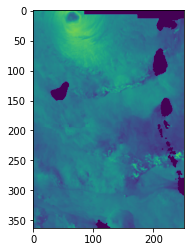

feature_cross normalised: 1.0 0.0
feature_cross masked: 0.64858013 0.0


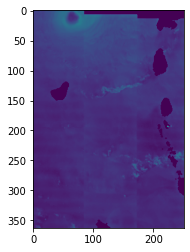

feature_wind normalised: 1.0 0.0
feature_wind masked: 1.0 0.0


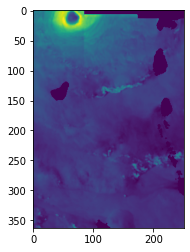

output: 1.0 0.0
--------------------- Test -----------------------
plt.imshow: all


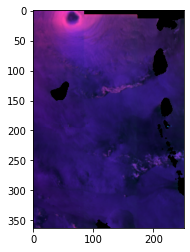

plt.imshow


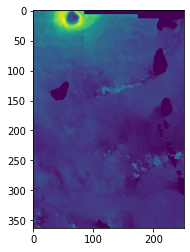

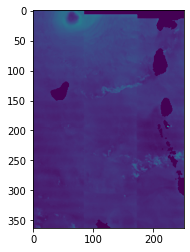

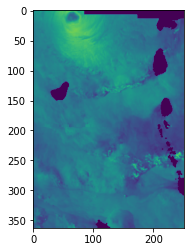

0 255
feature_co masked: 0.76631635 0.0
test masked: 0.76631635 0.0
feature_co normalised: 1.0 0.0


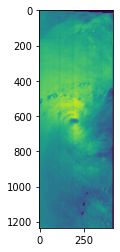

feature_cross normalised: 1.0 0.0
feature_cross masked: 0.62399375 0.0


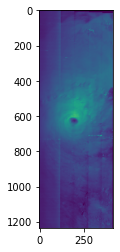

feature_wind normalised: 1.0 0.0
feature_wind masked: 1.0 0.0


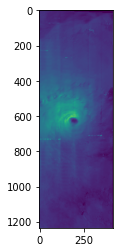

output: 1.0 0.0
--------------------- Test -----------------------
plt.imshow: all


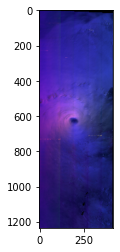

plt.imshow


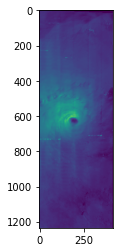

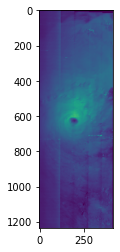

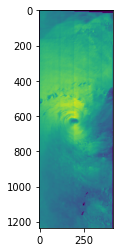

0 255
feature_co masked: 0.7770632 0.0
test masked: 0.7770632 0.0
feature_co normalised: 1.0 0.0


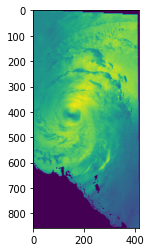

feature_cross normalised: 1.0 0.0
feature_cross masked: 0.33433855 0.0


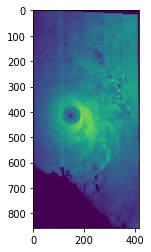

feature_wind normalised: 1.0 0.0
feature_wind masked: 1.0 0.0


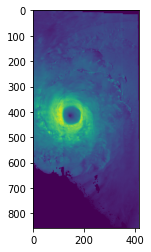

output: 1.0 0.0
--------------------- Test -----------------------
plt.imshow: all


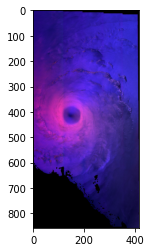

plt.imshow


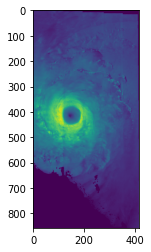

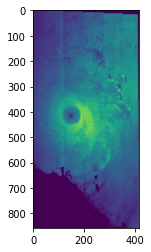

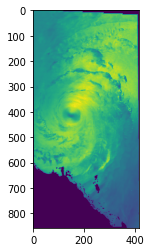

0 255
feature_co masked: 0.66517895 0.0
test masked: 0.66517895 0.0
feature_co normalised: 1.0 0.0


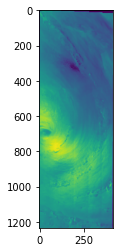

feature_cross normalised: 1.0 0.0
feature_cross masked: 1.0 0.0


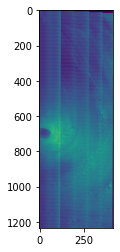

feature_wind normalised: 1.0 0.0
feature_wind masked: 1.0 0.0


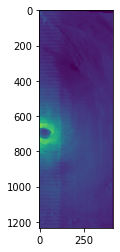

output: 1.0 0.0
--------------------- Test -----------------------
plt.imshow: all


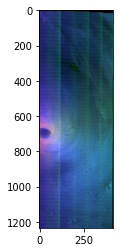

plt.imshow


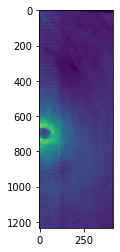

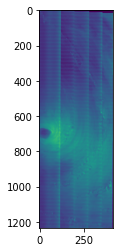

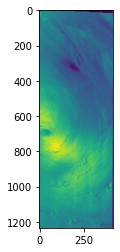

0 255
feature_co masked: 0.7186877 0.0
test masked: 0.7186877 0.0
feature_co normalised: 1.0 0.0


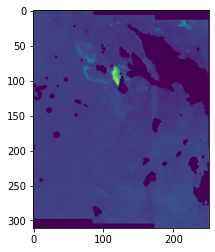

feature_cross normalised: 1.0 0.0
feature_cross masked: 0.8942177 0.0


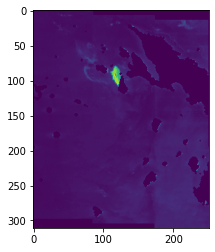

feature_wind normalised: 1.0 0.0
feature_wind masked: 1.0 0.0


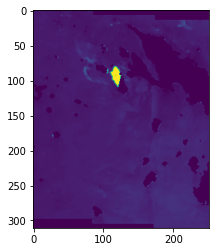

output: 1.0 0.0
--------------------- Test -----------------------
plt.imshow: all


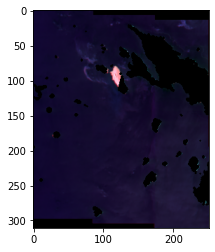

plt.imshow


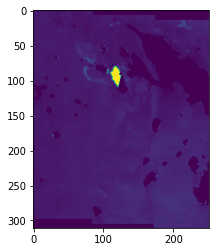

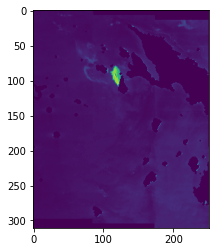

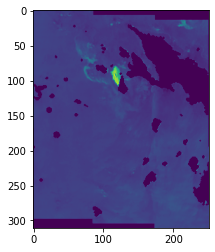

0 255


In [ ]:
# directory where nc files are
saved_dir = "SAR_swath_nc/category1"

# directory where corresponding images will be saved
#images_dir = "SAR_swath_images/category1"
#images_dir = "SAR_swath_masks/category5"
#os.makedirs(images_dir, exist_ok=True)
#lon_dir = images_dir + "/lon"
#os.makedirs(lon_dir, exist_ok=True)
#lat_dir = images_dir + "/lat"
#os.makedirs(lat_dir, exist_ok=True)
test_dir = 'test'
os.makedirs(test_dir, exist_ok=True)

nc_list = glob.glob("{}/*.nc".format(saved_dir))
count=0

for nc_image in nc_list[:5]:
  # read nc image
  full_info_image = netCDF4.Dataset(nc_image, mode='r') 

  # getting the information of the feature you want
  try:
    # extract mask flag
    mask = full_info_image.variables["mask_flag"][:]

    feature_co = full_info_image.variables["nrcs_detrend_co"][:]
    #print("feature_co: ", np.max(feature_co[0]), np.min(feature_co[0]))
    #plt.imshow(feature_co[0])
    #plt.show()
    test = feature_co[0]
    test[mask[0] != 0] = 0
    feature_co[0][mask[0] != 0] = 0
    print("feature_co masked:", np.max(feature_co[0]), np.min(feature_co[0]))
    print("test masked:", np.max(test), np.min(test))

    feature_co = (feature_co[0] - np.min(feature_co[0]))/(np.max(feature_co[0]) - np.min(feature_co[0]))
    print("feature_co normalised:", np.max(feature_co), np.min(feature_co))
    #feature_co[mask[0] != 0] = 0
    #print("feature_co masked:", np.max(feature_co), np.min(feature_co))
    plt.imshow(feature_co)
    plt.show()
    
  
    feature_cross = full_info_image.variables["nrcs_detrend_cross"][:]
    #print("feature_cross:", np.max(feature_cross[0]), np.min(feature_cross[0]))
    #plt.imshow(feature_cross[0])
    #plt.show()

    feature_cross = (feature_cross[0] - np.min(feature_cross[0]))/(np.max(feature_cross[0]) - np.min(feature_cross[0]))
    print("feature_cross normalised:", np.max(feature_cross), np.min(feature_cross))
    feature_cross[mask[0] != 0] = 0
    print("feature_cross masked:", np.max(feature_cross), np.min(feature_cross))
    plt.imshow(feature_cross)
    plt.show()


    feature_wind = full_info_image.variables["wind_speed"][:]
    #print("feature_wind:", np.max(feature_wind[0]), np.min(feature_wind[0]))
    #plt.imshow(feature_wind[0])
    #plt.show()


    feature_wind = (feature_wind[0] - np.min(feature_wind[0]))/(np.max(feature_wind[0]) - np.min(feature_wind[0]))
    print("feature_wind normalised:", np.max(feature_wind), np.min(feature_wind))
    feature_wind[mask[0] != 0] = 0
    print("feature_wind masked:", np.max(feature_wind), np.min(feature_wind))
    plt.imshow(feature_wind)
    plt.show()


    feature_wso = full_info_image.variables["wind_streaks_orientation"][:]
    #if np.isnan(feature_wso).any():
    #  count +=1
    #print(np.nanmax(feature_wso[0]), np.nanmin(feature_wso[0]))
    #print("feature_wso")
    #plt.imshow(feature_wso[0])
    #plt.show()

    feature_lon = full_info_image.variables["lon"][:]
    feature_lat = full_info_image.variables["lat"][:]

    tmax_units = datetime.datetime.strptime(full_info_image.measurementDate, '%Y-%m-%dT%H:%M:%SZ')
    tmax_units = tmax_units.strftime('%Y-%m-%d %H_%M_%S')

    # stack matrices along 3rd axis (depth-wise)
    output_image = np.dstack((feature_co, feature_cross, feature_wind))
    if (output_image < 0).any():
      output_image = np.clip(output_image, a_min=0, a_max=None)
    #print(output_image.shape)
    print("output:", np.max(output_image), np.min(output_image))
    #print("first output image")
    #plt.imshow(output_image)
    #plt.show()

    full_info_image.close()

  except KeyError as err:
    # Creating KeyError instance for book keeping.
    print("Error:", err)
    full_info_image.close()
    continue
    
  # mask out the land values
  #output_image[mask[0] != 0] = 0
  #print("output image masked")
  #print("after masking:", np.max(output_image), np.min(output_image))
  #plt.imshow(output_image)
  #plt.show()

  # normalise values between [0 ... 1]
  #norm_image = output_image/np.nanmax(output_image)
  #print("after normalising:", np.max(norm_image), np.min(norm_image))
  #print("output image normalised")
  #plt.imshow(norm_image)
  #plt.show()

  # save information extracted
  #cv2.imwrite("{}/{}.png".format(images_dir, tmax_units), output_image)
  plt.imsave("{}/{}.png".format(test_dir, tmax_units), output_image, format = 'png')
  #plt.imsave("{}/{}_mask.png".format(images_dir, tmax_units), mask, format = 'png')
  #np.save("{}/{}_mask.npy".format(images_dir, tmax_units), np.array(mask[0]))
  #np.save("{}/{}.npy".format(lon_dir, tmax_units), np.mean(feature_lon[0]))
  #np.save("{}/{}.npy".format(lat_dir, tmax_units), np.mean(feature_lat[0]))

  print("--------------------- Test -----------------------")
  a = cv2.imread("{}/{}.png".format(test_dir, tmax_units))
  #print("cv2_imshow")
  #cv2_imshow(a)
  print("plt.imshow: all")
  plt.imshow(a)
  plt.show()

  #print("feature_co")
  #print("cv2_imshow")
  #cv2_imshow(a[:,:,0])

  print("plt.imshow")
  plt.imshow(a[:,:,0])
  plt.show()
  plt.imshow(a[:,:,1])
  plt.show()
  plt.imshow(a[:,:,2])
  plt.show()

  print(np.min(a), np.max(a))


#print(count)

In [ ]:
a = cv2.imread("SAR_swath_images_VV+VH+WS/category1/2016-09-01 20_30_16.png")
print("cv2_imshow")
cv2_imshow(a)
print("plt.imshow")
plt.imshow(a)
plt.show()

print("feature_co")
print("cv2_imshow")
cv2_imshow(a[:,:,0])

print("plt.imshow")
plt.imshow(a[:,:,0])
plt.show()

print(np.min(a), np.max(a))
b = a/np.max(a)
print(np.min(b), np.max(b))
print("cv2_imshow")
cv2_imshow(b)
print("plt.imshow")
plt.imshow(b)
plt.show()

#c = cv2.imread("SAR_swath_images_VV+VH+VH/category1/2016-09-15 14_12_58.png")
#cv2_imshow(c)
#print(np.min(c), np.max(c))
#d = c/np.max(c)
#cv2_imshow(d)

cv2_imshow


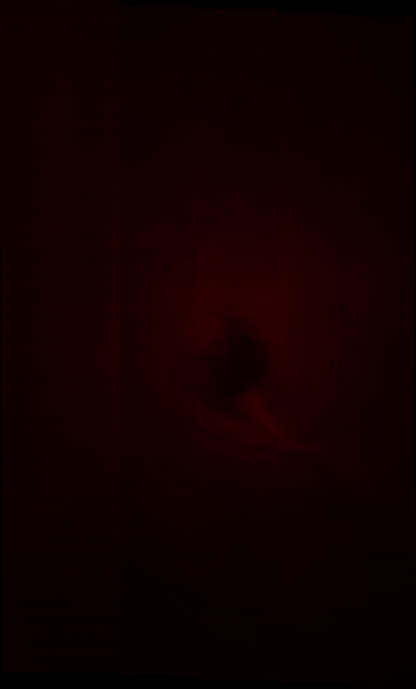

plt.imshow


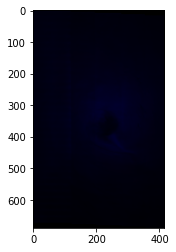

feature_co
cv2_imshow


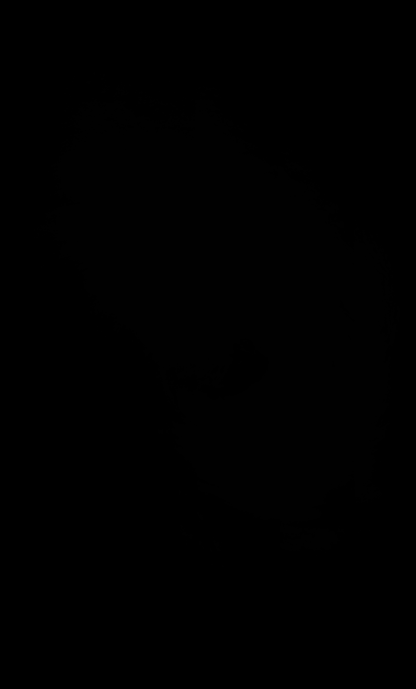

plt.imshow


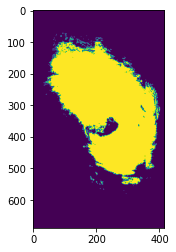

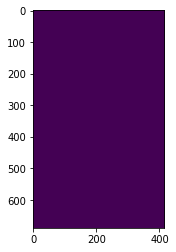

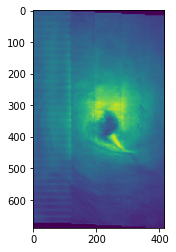

0 49


In [ ]:
a = cv2.imread("SAR_swath_images/category1/2016-09-01 20_30_16.png")
print("cv2_imshow")
cv2_imshow(a)
print("plt.imshow")
plt.imshow(a)
plt.show()

print("feature_co")
print("cv2_imshow")
cv2_imshow(a[:,:,0])

print("plt.imshow")
plt.imshow(a[:,:,0])
plt.show()
plt.imshow(a[:,:,1])
plt.show()
plt.imshow(a[:,:,2])
plt.show()

print(np.min(a), np.max(a))

cv2_imshow


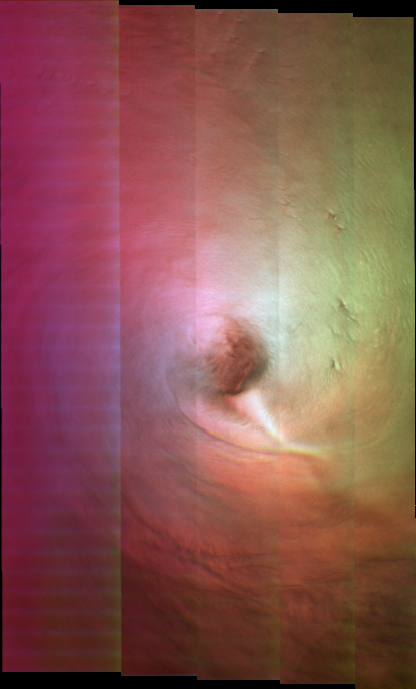

plt.imshow


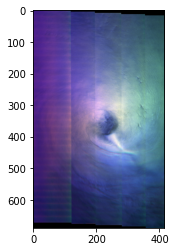

feature_co
cv2_imshow


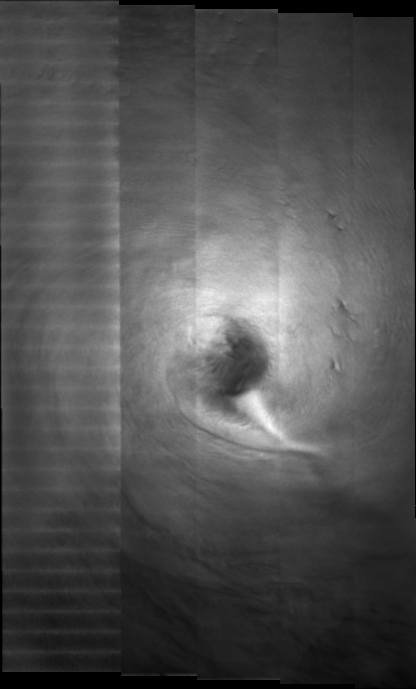

plt.imshow


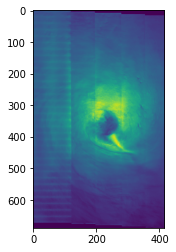

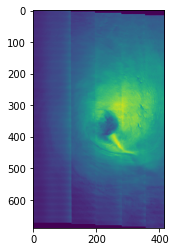

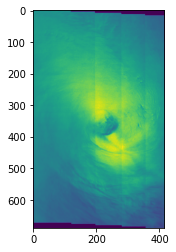

0 255


In [ ]:
a = cv2.imread("SAR_swath_images_VV+VH+WS/category1/2016-09-01 20_30_16.png")
print("cv2_imshow")
cv2_imshow(a)
print("plt.imshow")
plt.imshow(a)
plt.show()

print("feature_co")
print("cv2_imshow")
cv2_imshow(a[:,:,0])

print("plt.imshow")
plt.imshow(a[:,:,0])
plt.show()
plt.imshow(a[:,:,1])
plt.show()
plt.imshow(a[:,:,2])
plt.show()

print(np.min(a), np.max(a))

cv2_imshow


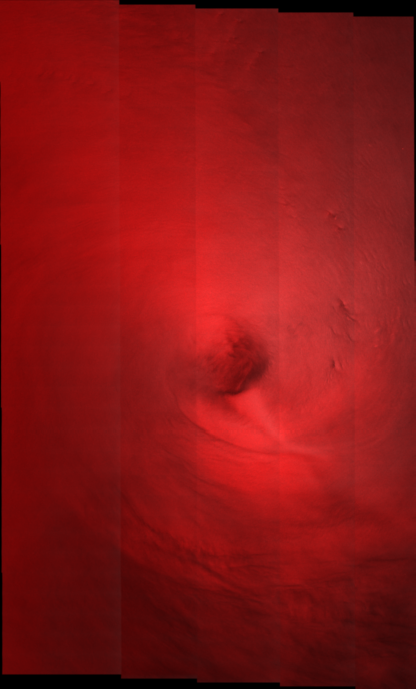

plt.imshow


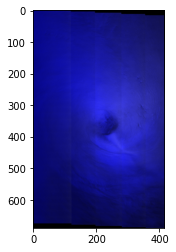

feature_co
cv2_imshow


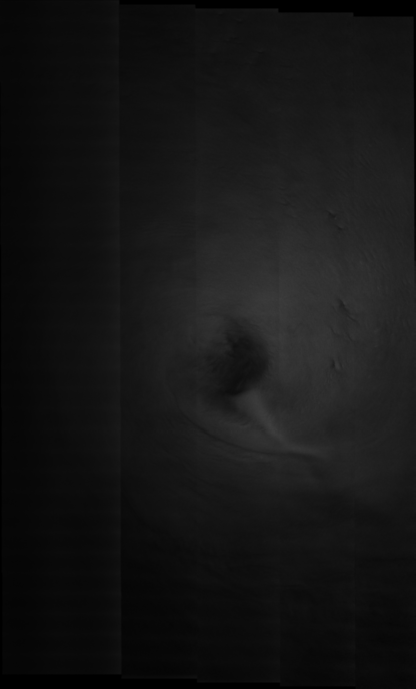

plt.imshow


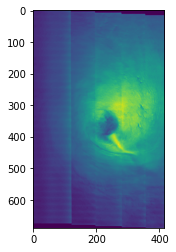

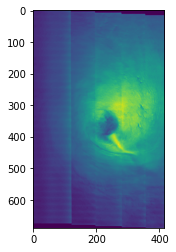

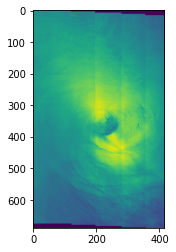

0 255


In [ ]:
a = cv2.imread("SAR_swath_images_VV+VH+VH/category1/2016-09-01 20_30_16.png")
print("cv2_imshow")
cv2_imshow(a)
print("plt.imshow")
plt.imshow(a)
plt.show()

print("feature_co")
print("cv2_imshow")
cv2_imshow(a[:,:,0])

print("plt.imshow")
plt.imshow(a[:,:,0])
plt.show()
plt.imshow(a[:,:,1])
plt.show()
plt.imshow(a[:,:,2])
plt.show()

print(np.min(a), np.max(a))

cv2_imshow


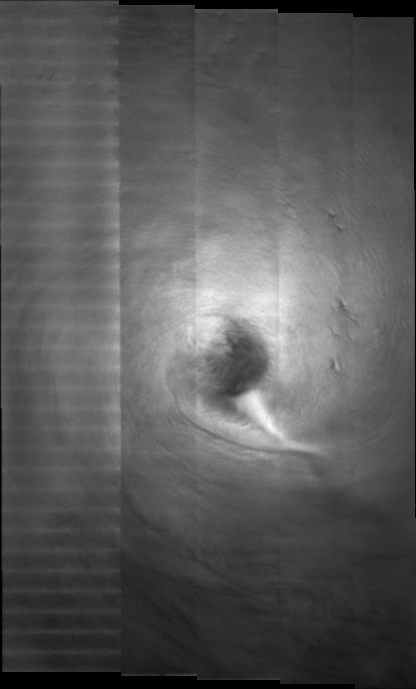

plt.imshow


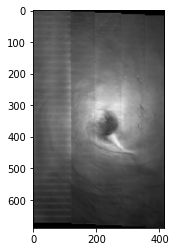

feature_co
cv2_imshow


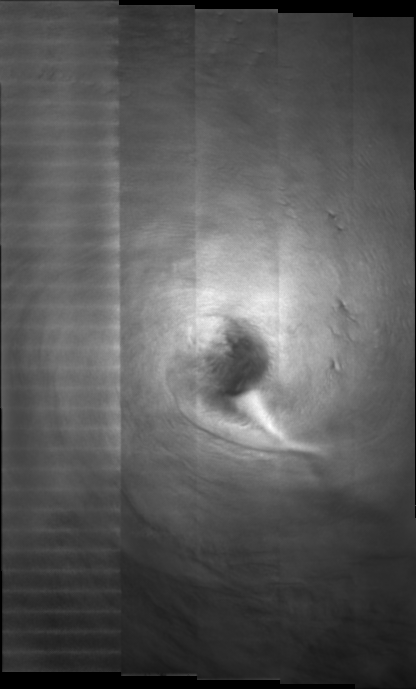

plt.imshow


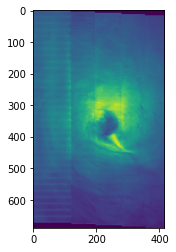

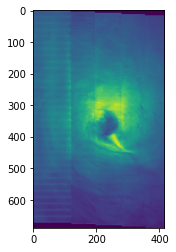

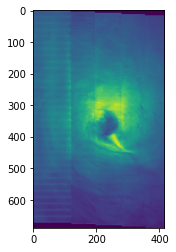

0 255


In [ ]:
a = cv2.imread("SAR_swath_images_WS+WS+WS/category1/2016-09-01 20_30_16.png")
print("cv2_imshow")
cv2_imshow(a)
print("plt.imshow")
plt.imshow(a)
plt.show()

print("feature_co")
print("cv2_imshow")
cv2_imshow(a[:,:,1])

print("plt.imshow")
plt.imshow(a[:,:,0])
plt.show()
plt.imshow(a[:,:,1])
plt.show()
plt.imshow(a[:,:,2])
plt.show()

print(np.min(a), np.max(a))

cv2_imshow


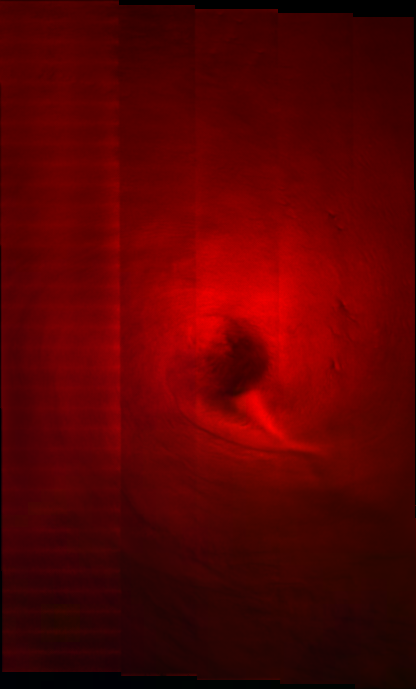

plt.imshow


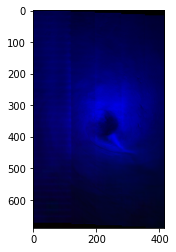

feature_co
cv2_imshow


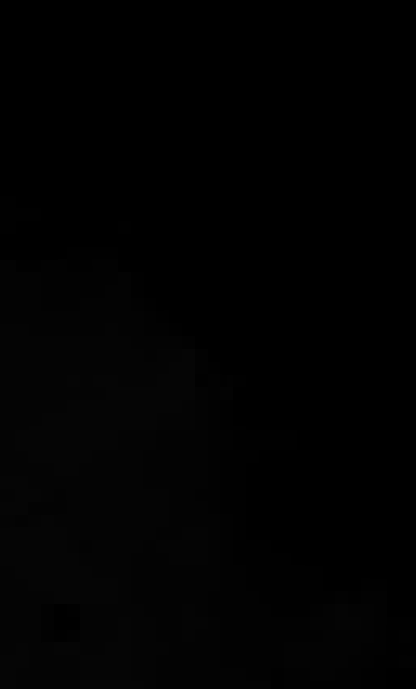

plt.imshow


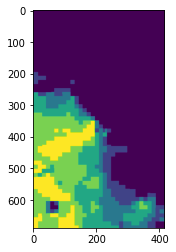

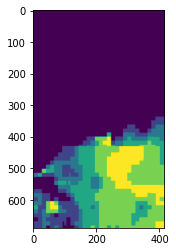

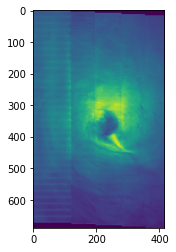

0 255


In [ ]:
a = cv2.imread("SAR_swath_images_WS+sWSO+cWSO/category1/2016-09-01 20_30_16.png")
print("cv2_imshow")
cv2_imshow(a)
print("plt.imshow")
plt.imshow(a)
plt.show()

print("feature_co")
print("cv2_imshow")
cv2_imshow(a[:,:,0])

print("plt.imshow")
plt.imshow(a[:,:,0])
plt.show()
plt.imshow(a[:,:,1])
plt.show()
plt.imshow(a[:,:,2])
plt.show()

print(np.min(a), np.max(a))

Script to delete double files.

In [ ]:
source_folder = "/content/drive/My Drive/ESRIN_PhiLab/Tropical_Cyclones/data/SAR_swath_images_VV+VH+VH/category1"
source_files = glob.glob(source_folder + '/*.png')
len(source_files)

70

In [ ]:
folder_to_delete = "/content/drive/My Drive/ESRIN_PhiLab/Tropical_Cyclones/data/SAR_swath_images_VV+VH+VH/category2"
files_to_delete = glob.glob(folder_to_delete + '/*.png')

source_folder = "/content/drive/My Drive/ESRIN_PhiLab/Tropical_Cyclones/data/SAR_swath_images_VV+VH+VH/category1"
source_files = glob.glob(source_folder + '/*.png')

for f in files_to_delete:
    f = f.split('/')[-1]
    for s in source_files:
        s = s.split('/')[-1]
        if f == s:
          print('File removed:', s)
          os.remove(source_folder + '/' + s)

Script to create the split between csv files.

In [5]:
LABELS_PATH = "/content/drive/My Drive/ESRIN_PhiLab/Tropical_Cyclones/data/SAR_IMAGE_DATASET_EYE_CLASSIFICATION/labels/via_project_11Jan2021_12h22m_csv.csv"
#labels_path_file = glob.glob('{}/*.csv'.format(LABELS_PATH))
## in case there is no txt file for that image
#if labels_path_file == []:
#  print("No labels file found.")
#  sys.exit(0)

import re
import random

#df = pd.read_csv(labels_path_file[0])
df = pd.read_csv(LABELS_PATH)
cols = df.columns.tolist()
for idx, row in df.iterrows():
  # retrieve the coordinates of the bounding boxes
  df['region_shape_attributes'][idx] = re.findall(r'\d+', df['region_shape_attributes'][idx])

images_dir = "SAR_swath_images_VH+VH+VH/"
category = ["category1/", "category2/", "category3/", "category4/", "category5/"]

# use a seed so to obtain the same splitting every time
random.seed(20)

df_train = [] 
df_val = [] 
df_test = [] 
df_full = []

for cat in category:
  dir = images_dir + cat
  lon_dir = dir + "lon"
  lat_dir = dir + "lat"

  image_list = glob.glob('{}/*.png'.format(dir))

  for image_path in image_list:
    print(image_path)
    image_name = os.path.basename(image_path)

    lon_list = glob.glob('{}/{}.npy'.format(lon_dir, image_name.split('.')[0]))
    lat_list = glob.glob('{}/{}.npy'.format(lat_dir, image_name.split('.')[0]))

    lon = lon_list[0] if lon_list != [] else None
    lat = lat_list[0] if lat_list != [] else None

    aux = [image_path]
    aux.extend([lat, lon])
    #print(df[df.filename == image_name])
    index = df[df.filename == image_name].index[0]
    bb_present = 1 if df['region_count'][index] == 1 else 0
    aux.append(bb_present)
    aux.append(df['region_shape_attributes'][index])

    df_full.append(aux)
    rand = random.randint(0, 100)
    # split used 60, 20, 20
    if rand < 60:
      df_train.append(aux)
    elif rand < 80:
      df_val.append(aux)
    else:
      df_test.append(aux) 

col_names = ['image', 'lat', 'lon', 'label', 'bbox_shape']
df_train = pd.DataFrame(df_train, columns = col_names)
df_val = pd.DataFrame(df_val, columns = col_names)
df_test = pd.DataFrame(df_test, columns = col_names)
df_full = pd.DataFrame(df_full, columns = col_names)

# create path to save the csv files
CSV_PATH = images_dir + 'csv'
os.makedirs(CSV_PATH, exist_ok=True)

if df_train.empty == False:
  df_train.to_csv('{}/training.csv'.format(CSV_PATH), index = False)

if df_val.empty == False:
  df_val.to_csv('{}/val.csv'.format(CSV_PATH), index = False)

if df_test.empty == False:
  df_test.to_csv('{}/test.csv'.format(CSV_PATH), index = False)

if df_full.empty == False:
  df_full.to_csv('{}/full_dataset.csv'.format(CSV_PATH), index = False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


SAR_swath_images_VH+VH+VH/category1/2018-04-09 17_32_19.png
SAR_swath_images_VH+VH+VH/category1/2019-03-29 14_03_33.png
SAR_swath_images_VH+VH+VH/category1/2017-05-04 07_14_33.png
SAR_swath_images_VH+VH+VH/category1/2019-03-24 10_38_56.png
SAR_swath_images_VH+VH+VH/category1/2018-09-30 14_03_11.png
SAR_swath_images_VH+VH+VH/category1/2018-08-29 07_55_10.png
SAR_swath_images_VH+VH+VH/category1/2019-03-21 20_15_14.png
SAR_swath_images_VH+VH+VH/category1/2018-09-27 01_28_12.png
SAR_swath_images_VH+VH+VH/category1/2018-08-31 03_32_35.png
SAR_swath_images_VH+VH+VH/category1/2017-08-05 09_28_53.png
SAR_swath_images_VH+VH+VH/category1/2019-03-06 13_54_29.png
SAR_swath_images_VH+VH+VH/category1/2019-10-02 08_05_05.png
SAR_swath_images_VH+VH+VH/category1/2017-02-15 16_14_28.png
SAR_swath_images_VH+VH+VH/category1/2020-09-15 23_53_25.png
SAR_swath_images_VH+VH+VH/category1/2019-02-16 07_21_54.png
SAR_swath_images_VH+VH+VH/category1/2016-09-01 20_30_16.png
SAR_swath_images_VH+VH+VH/category1/2019

Script to test the location of the bounding boxes around the eye.

Image: SAR_swath_images_VV+VH+WS/category1/2016-09-01 20_30_16.png label: 1


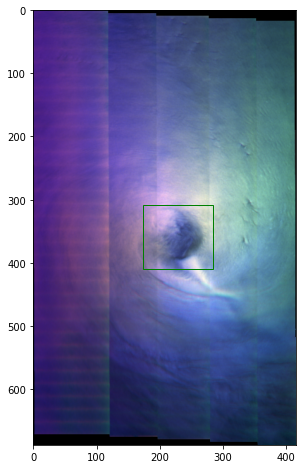

Image: SAR_swath_images_VV+VH+WS/category1/2016-09-15 14_12_58.png label: 0


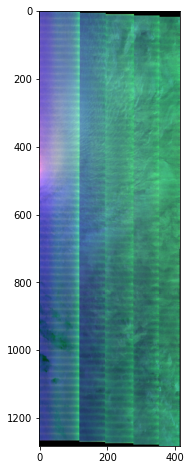

Image: SAR_swath_images_VV+VH+WS/category1/2017-03-04 14_45_59.png label: 0


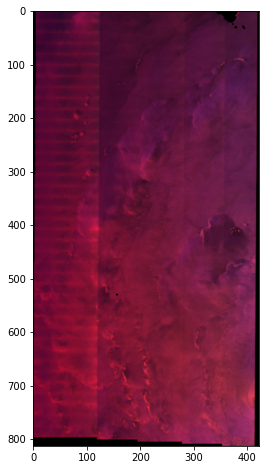

Image: SAR_swath_images_VV+VH+WS/category1/2018-01-17 14_37_29.png label: 1


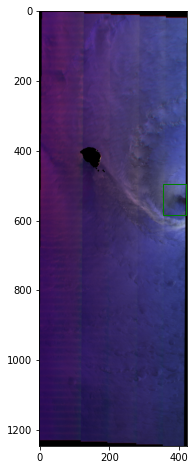

Image: SAR_swath_images_VV+VH+WS/category1/2018-07-26 20_37_36.png label: 1


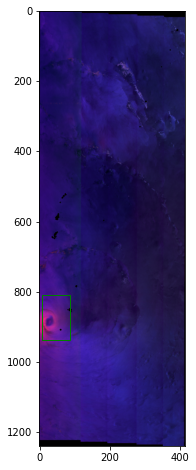

Image: SAR_swath_images_VV+VH+WS/category1/2018-08-09 01_38_08.png label: 1


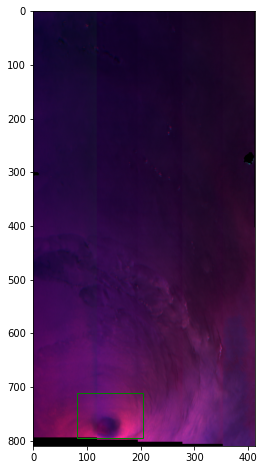

Image: SAR_swath_images_VV+VH+WS/category1/2018-08-12 17_29_50.png label: 0


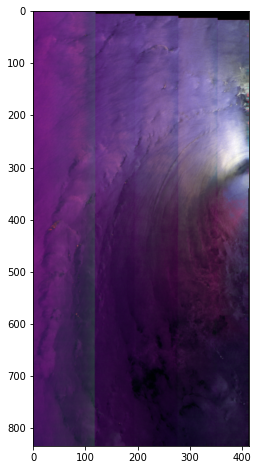

Image: SAR_swath_images_VV+VH+WS/category1/2018-08-31 03_32_35.png label: 1


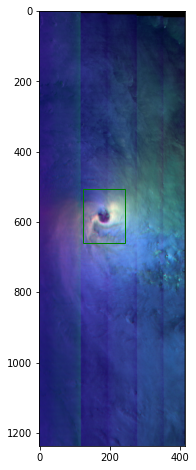

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-04 21_06_36.png label: 0


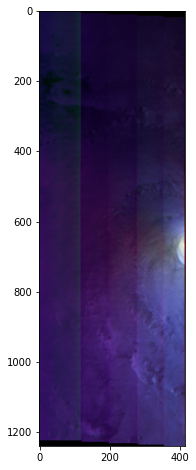

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-05 03_42_06.png label: 1


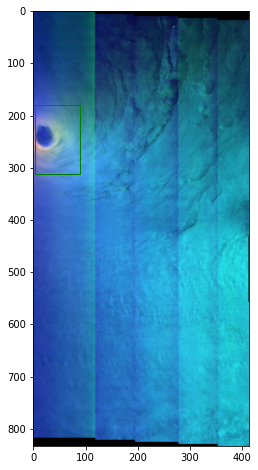

Image: SAR_swath_images_VV+VH+WS/category1/2018-10-09 14_30_08.png label: 1


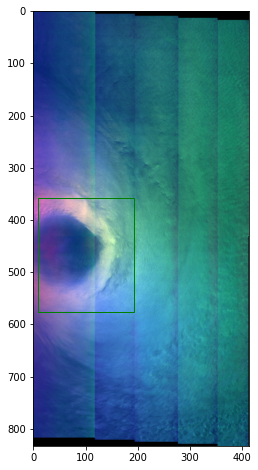

Image: SAR_swath_images_VV+VH+WS/category1/2018-10-13 07_17_18.png label: 1


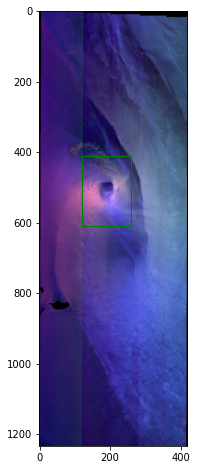

Image: SAR_swath_images_VV+VH+WS/category1/2019-02-07 02_09_42.png label: 1


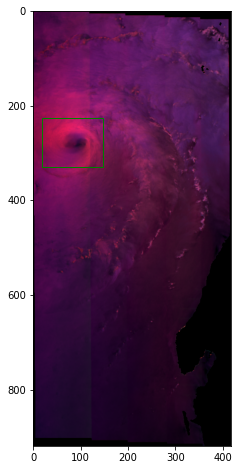

Image: SAR_swath_images_VV+VH+WS/category1/2019-02-16 07_21_54.png label: 1


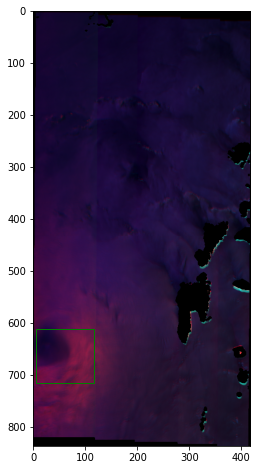

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-01 06_21_55.png label: 1


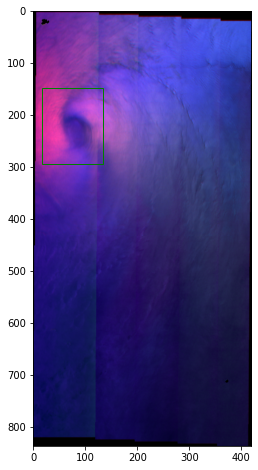

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-24 10_38_56.png label: 1


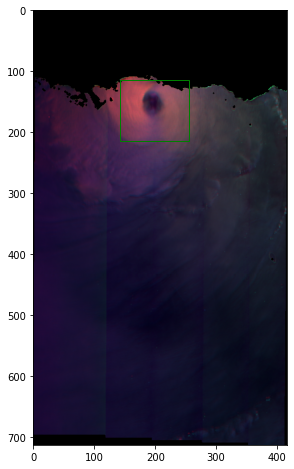

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-29 14_03_33.png label: 1


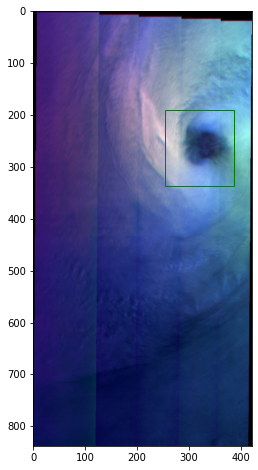

Image: SAR_swath_images_VV+VH+WS/category1/2019-04-25 23_41_41.png label: 0


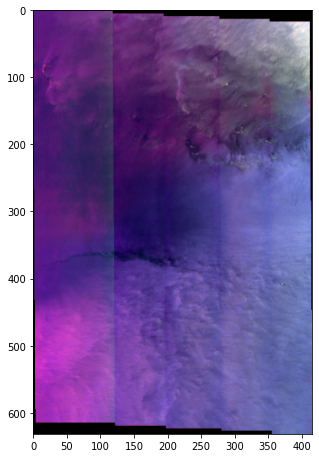

Image: SAR_swath_images_VV+VH+WS/category1/2019-04-27 12_34_26.png label: 1


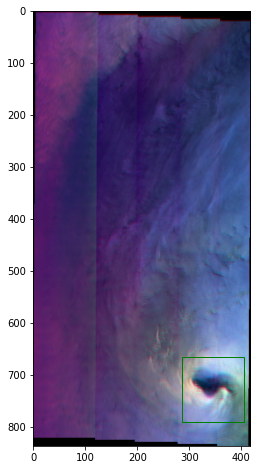

Image: SAR_swath_images_VV+VH+WS/category1/2019-11-07 19_40_44.png label: 1


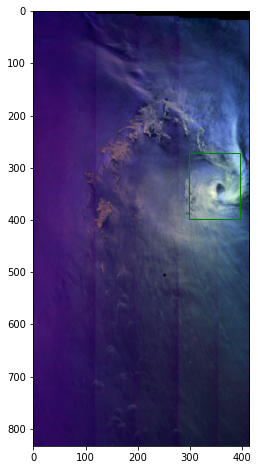

Image: SAR_swath_images_VV+VH+WS/category1/2019-12-07 02_33_11.png label: 1


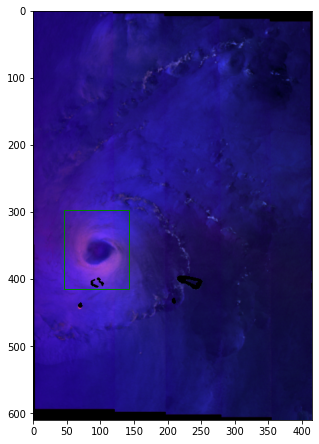

Image: SAR_swath_images_VV+VH+WS/category1/2019-12-31 14_45_18.png label: 1


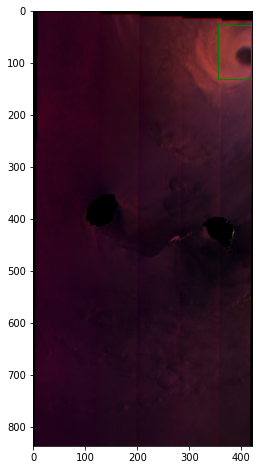

Image: SAR_swath_images_VV+VH+WS/category1/2020-03-16 02_02_20.png label: 1


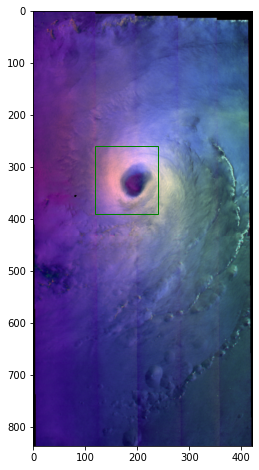

Image: SAR_swath_images_VV+VH+WS/category1/2016-08-29 08_32_39.png label: 1


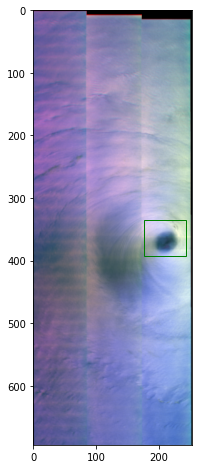

Image: SAR_swath_images_VV+VH+WS/category1/2016-09-01 23_45_19.png label: 1


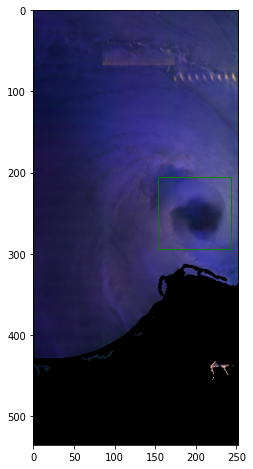

Image: SAR_swath_images_VV+VH+WS/category1/2016-12-12 00_31_35.png label: 0


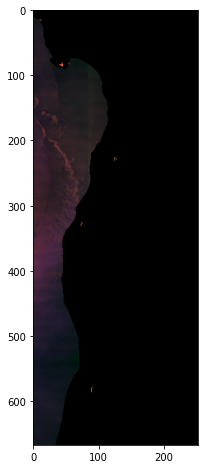

Image: SAR_swath_images_VV+VH+WS/category1/2017-02-15 16_14_28.png label: 1


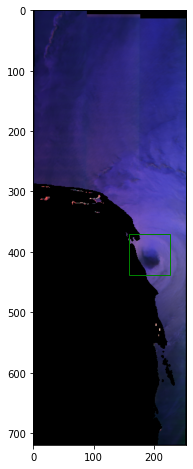

Image: SAR_swath_images_VV+VH+WS/category1/2017-05-04 07_14_33.png label: 1


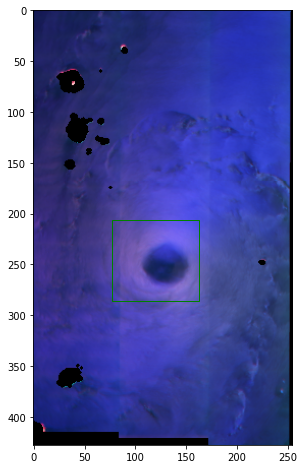

Image: SAR_swath_images_VV+VH+WS/category1/2018-04-09 17_32_19.png label: 0


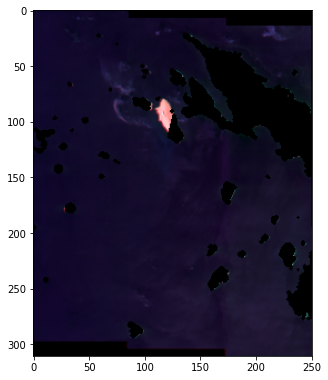

Image: SAR_swath_images_VV+VH+WS/category1/2019-09-06 22_42_11.png label: 1


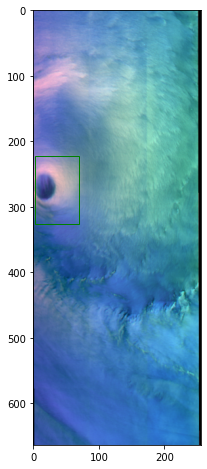

Image: SAR_swath_images_VV+VH+WS/category1/2019-09-20 13_06_41.png label: 1


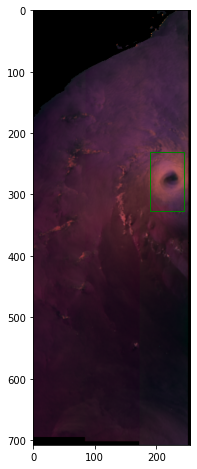

Image: SAR_swath_images_VV+VH+WS/category1/2019-10-02 08_05_05.png label: 1


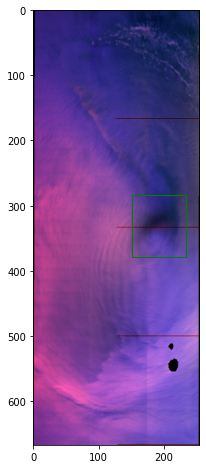

Image: SAR_swath_images_VV+VH+WS/category1/2020-08-03 10_02_07.png label: 1


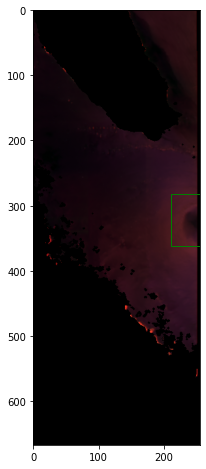

Image: SAR_swath_images_VV+VH+WS/category1/2020-08-03 23_13_48.png label: 1


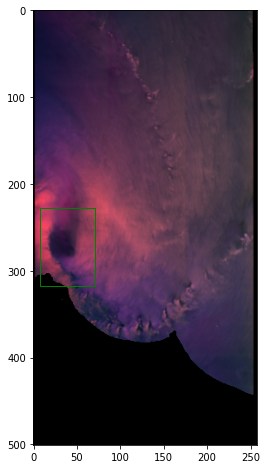

Image: SAR_swath_images_VV+VH+WS/category1/2020-09-16 09_27_00.png label: 0


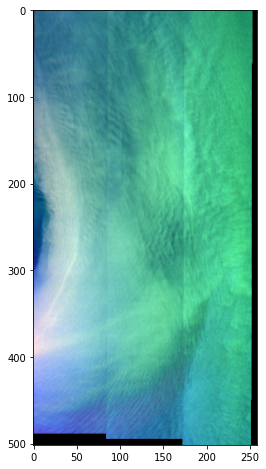

Image: SAR_swath_images_VV+VH+WS/category1/2020-10-05 23_33_59.png label: 0


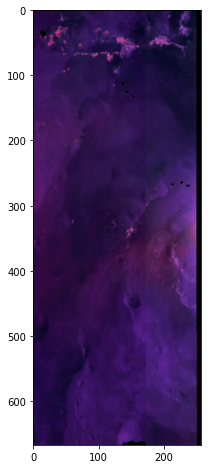

Image: SAR_swath_images_VV+VH+WS/category1/2020-10-08 09_13_35.png label: 1


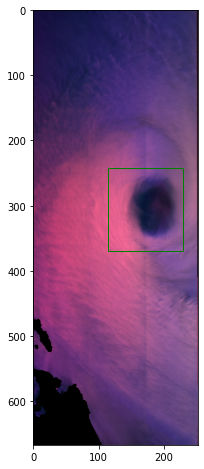

Image: SAR_swath_images_VV+VH+WS/category1/2018-08-08 08_24_54.png label: 1


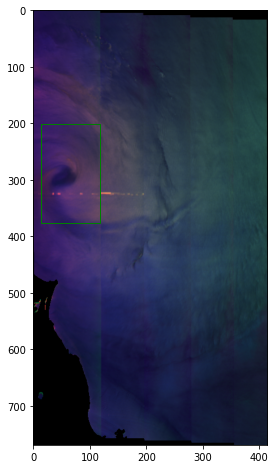

Image: SAR_swath_images_VV+VH+WS/category1/2018-08-29 07_55_10.png label: 1


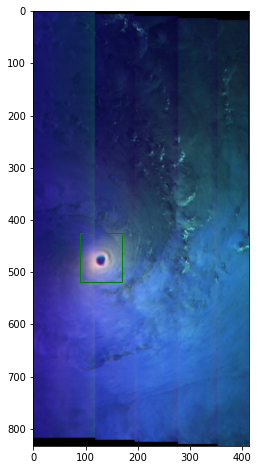

Image: SAR_swath_images_VV+VH+WS/category1/2018-08-30 03_39_40.png label: 0


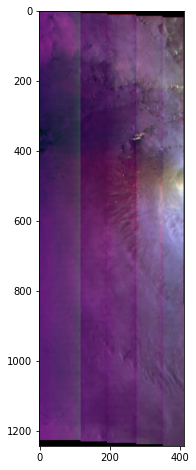

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-01 03_24_42.png label: 1


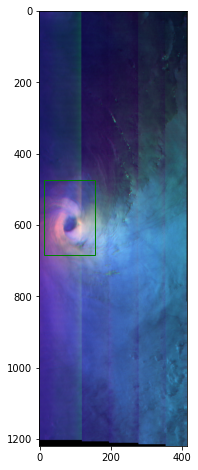

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-07 04_15_08.png label: 1


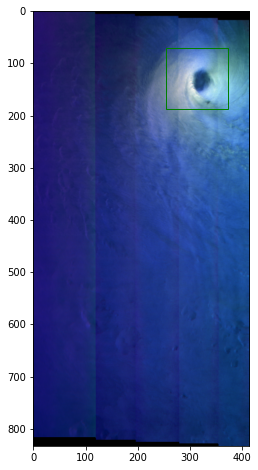

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-12 08_19_24.png label: 1


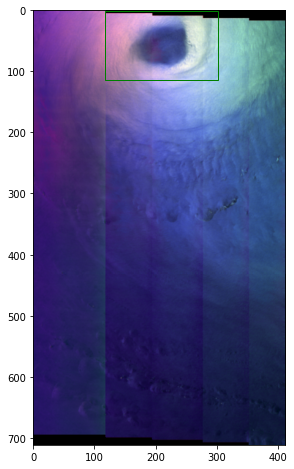

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-27 01_28_12.png label: 0


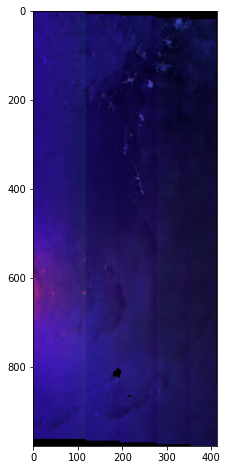

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-30 14_03_11.png label: 0


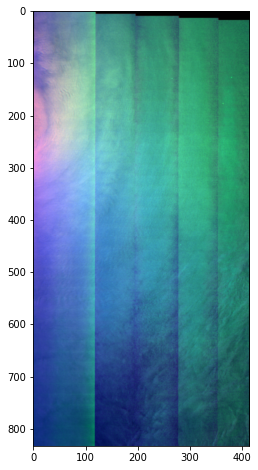

Image: SAR_swath_images_VV+VH+WS/category1/2018-10-08 23_51_31.png label: 1


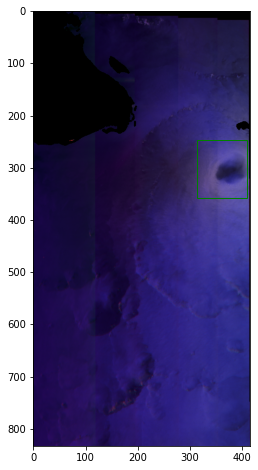

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-03 13_32_10.png label: 1


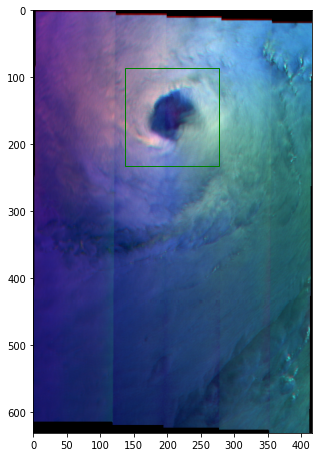

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-06 13_54_29.png label: 1


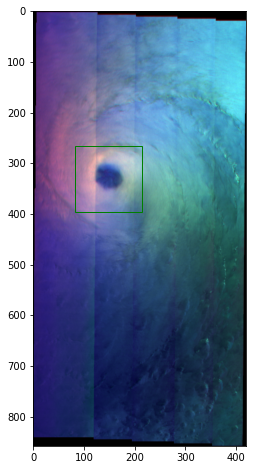

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-07 00_49_28.png label: 1


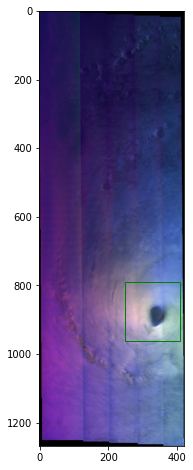

Image: SAR_swath_images_VV+VH+WS/category1/2019-03-21 20_15_14.png label: 1


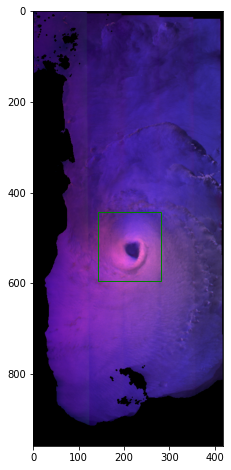

Image: SAR_swath_images_VV+VH+WS/category1/2019-04-26 23_33_12.png label: 0


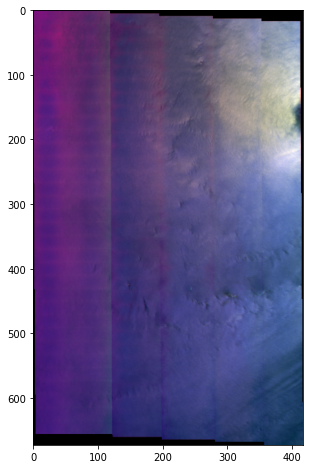

Image: SAR_swath_images_VV+VH+WS/category1/2019-04-28 12_24_41.png label: 1


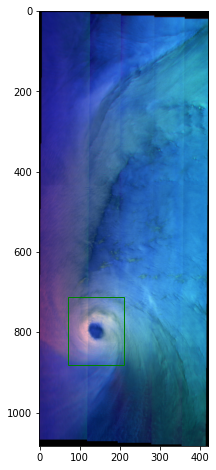

Image: SAR_swath_images_VV+VH+WS/category1/2019-06-14 13_33_44.png label: 1


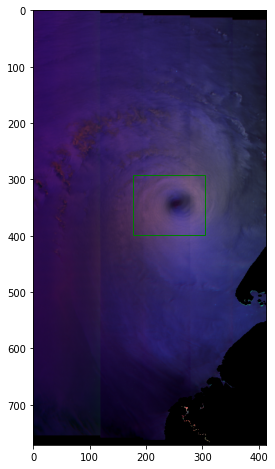

Image: SAR_swath_images_VV+VH+WS/category1/2019-09-06 14_11_56.png label: 1


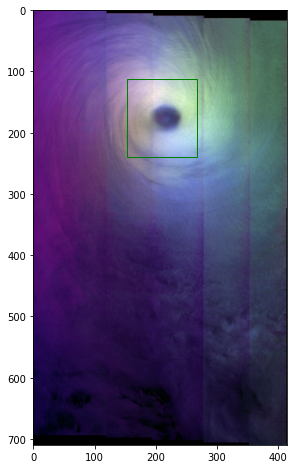

Image: SAR_swath_images_VV+VH+WS/category1/2020-10-04 14_29_05.png label: 1


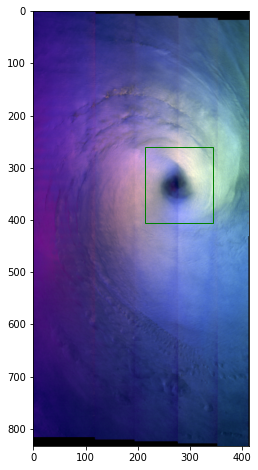

Image: SAR_swath_images_VV+VH+WS/category1/2017-08-05 09_28_53.png label: 0


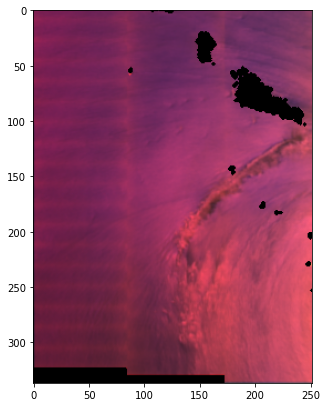

Image: SAR_swath_images_VV+VH+WS/category1/2017-10-15 18_44_20.png label: 1


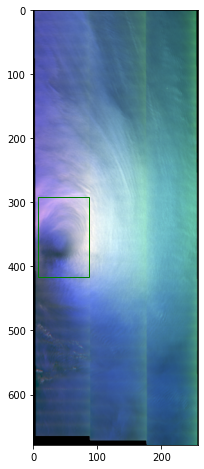

Image: SAR_swath_images_VV+VH+WS/category1/2017-10-28 09_28_41.png label: 1


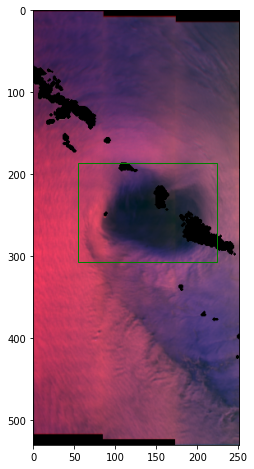

Image: SAR_swath_images_VV+VH+WS/category1/2018-07-03 01_43_44.png label: 0


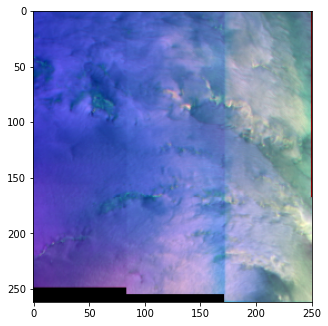

Image: SAR_swath_images_VV+VH+WS/category1/2018-09-14 11_15_28.png label: 1


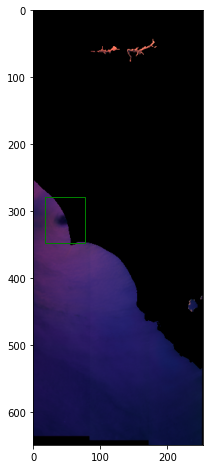

Image: SAR_swath_images_VV+VH+WS/category1/2018-10-02 01_35_08.png label: 1


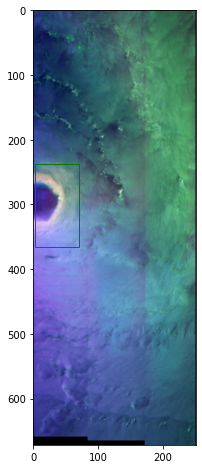

Image: SAR_swath_images_VV+VH+WS/category1/2019-08-29 10_21_54.png label: 1


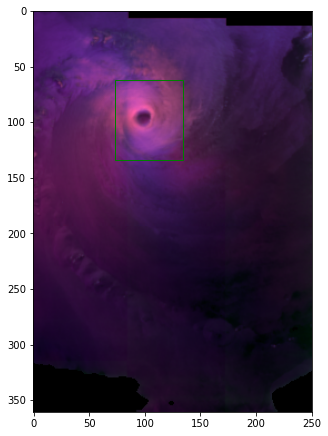

Image: SAR_swath_images_VV+VH+WS/category1/2019-09-19 01_04_35.png label: 1


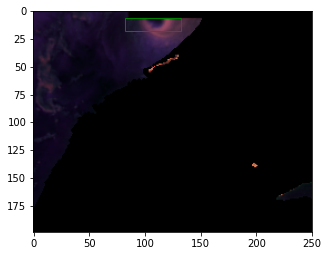

Image: SAR_swath_images_VV+VH+WS/category1/2019-10-12 08_41_20.png label: 1


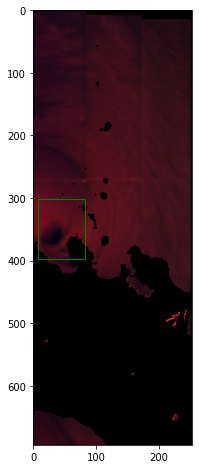

Image: SAR_swath_images_VV+VH+WS/category1/2019-11-19 09_59_04.png label: 1


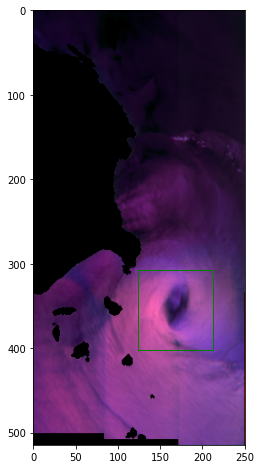

Image: SAR_swath_images_VV+VH+WS/category1/2020-09-06 21_32_37.png label: 0


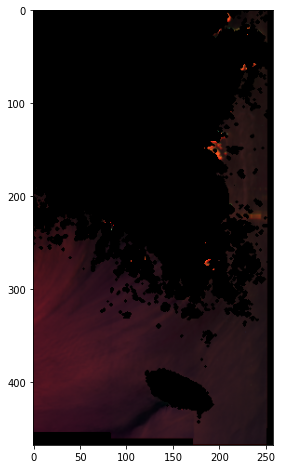

Image: SAR_swath_images_VV+VH+WS/category1/2020-09-15 23_53_25.png label: 1


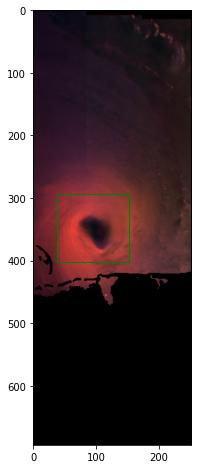

Image: SAR_swath_images_VV+VH+WS/category1/2020-10-08 00_07_54.png label: 1


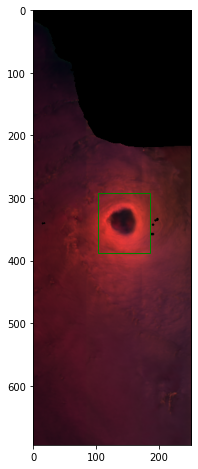

Image: SAR_swath_images_VV+VH+WS/category1/2020-10-26 23_58_54.png label: 1


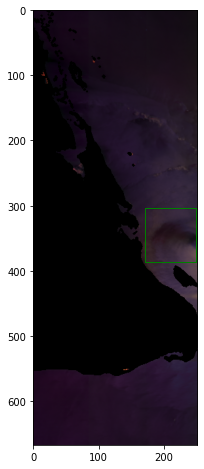

Image: SAR_swath_images_VV+VH+WS/category1/2020-11-01 09_58_07.png label: 0


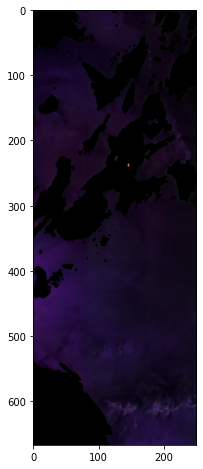

Image: SAR_swath_images_VV+VH+WS/category2/2016-08-29 21_42_01.png label: 1


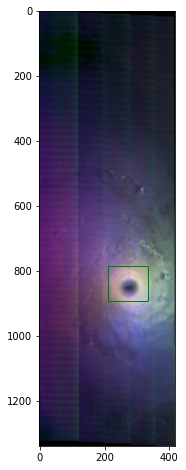

Image: SAR_swath_images_VV+VH+WS/category2/2016-08-30 09_45_44.png label: 1


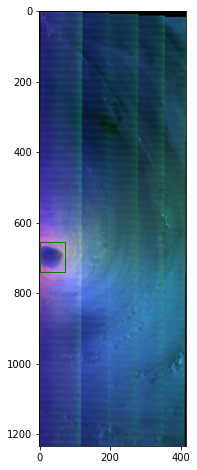

Image: SAR_swath_images_VV+VH+WS/category2/2016-09-26 09_35_31.png label: 1


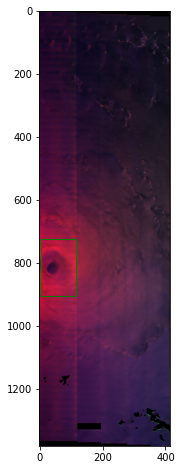

Image: SAR_swath_images_VV+VH+WS/category2/2018-02-03 13_06_58.png label: 0


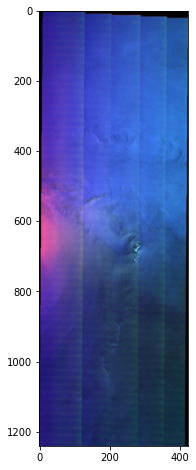

Image: SAR_swath_images_VV+VH+WS/category2/2018-03-04 14_54_47.png label: 0


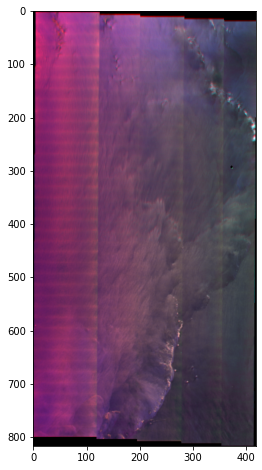

Image: SAR_swath_images_VV+VH+WS/category2/2018-08-03 02_26_05.png label: 0


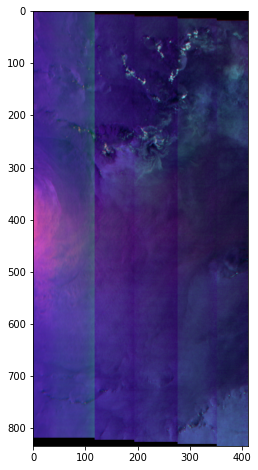

Image: SAR_swath_images_VV+VH+WS/category2/2018-08-03 14_39_05.png label: 0


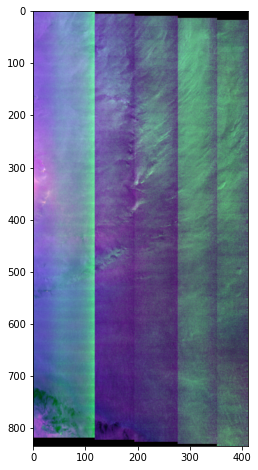

Image: SAR_swath_images_VV+VH+WS/category2/2018-08-07 08_32_36.png label: 1


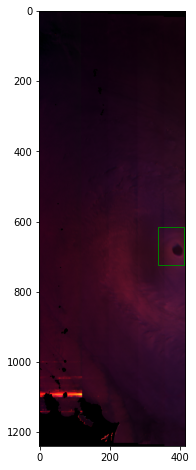

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-28 09_36_06.png label: 1


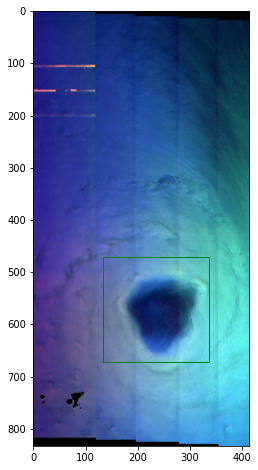

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-29 02_02_06.png label: 1


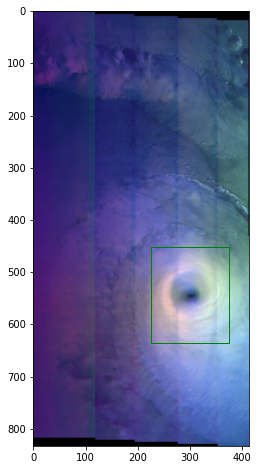

Image: SAR_swath_images_VV+VH+WS/category2/2019-02-21 19_53_43.png label: 1


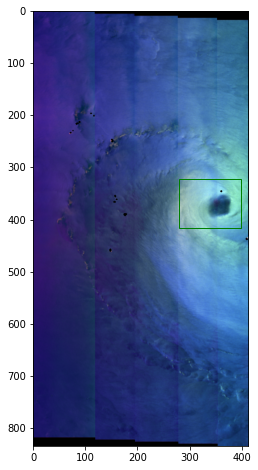

Image: SAR_swath_images_VV+VH+WS/category2/2019-03-06 00_58_22.png label: 0


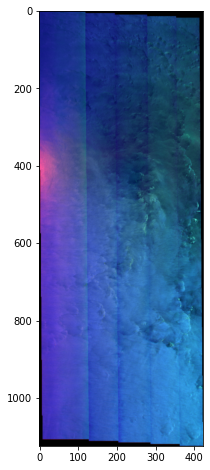

Image: SAR_swath_images_VV+VH+WS/category2/2019-03-11 02_44_12.png label: 1


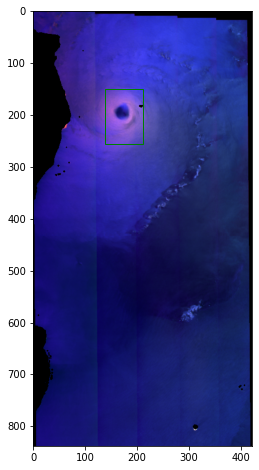

Image: SAR_swath_images_VV+VH+WS/category2/2019-03-22 21_47_46.png label: 1


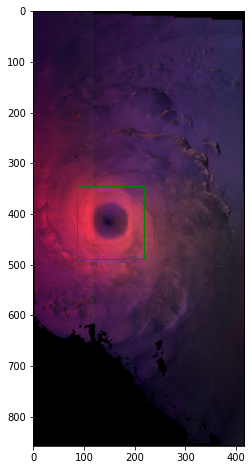

Image: SAR_swath_images_VV+VH+WS/category2/2019-09-04 13_40_26.png label: 1


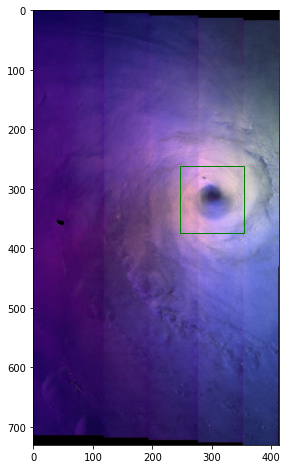

Image: SAR_swath_images_VV+VH+WS/category2/2019-09-30 21_00_52.png label: 0


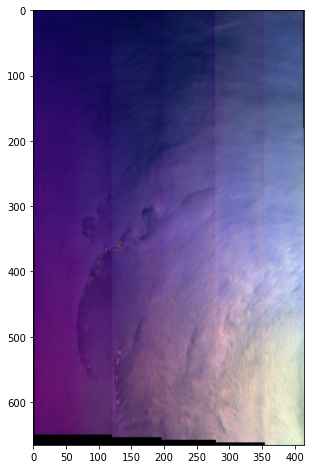

Image: SAR_swath_images_VV+VH+WS/category2/2020-09-21 22_16_07.png label: 0


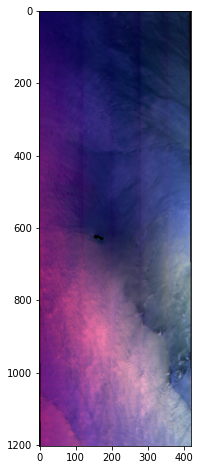

Image: SAR_swath_images_VV+VH+WS/category2/2020-09-22 10_17_34.png label: 1


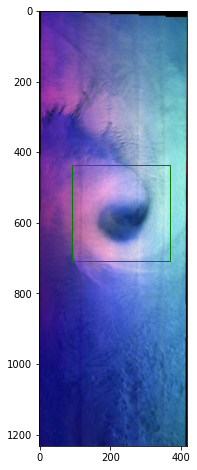

Image: SAR_swath_images_VV+VH+WS/category2/2017-09-10 23_28_16.png label: 0


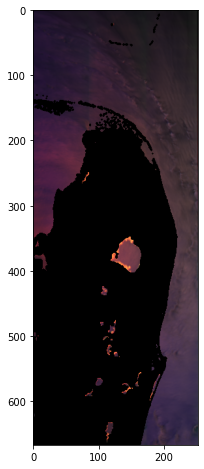

Image: SAR_swath_images_VV+VH+WS/category2/2017-09-18 09_51_25.png label: 1


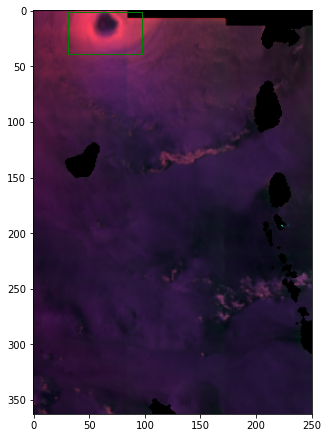

Image: SAR_swath_images_VV+VH+WS/category2/2018-08-07 20_35_33.png label: 1


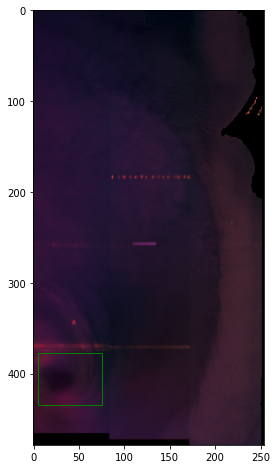

Image: SAR_swath_images_VV+VH+WS/category2/2018-08-22 21_01_25.png label: 1


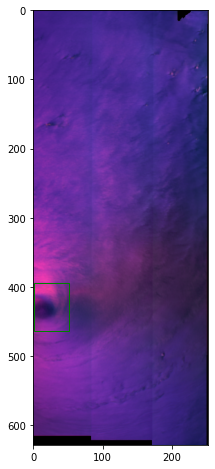

Image: SAR_swath_images_VV+VH+WS/category2/2018-10-24 01_06_05.png label: 1


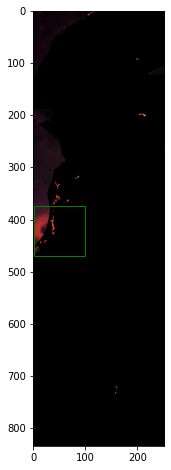

Image: SAR_swath_images_VV+VH+WS/category2/2019-03-19 08_54_01.png label: 0


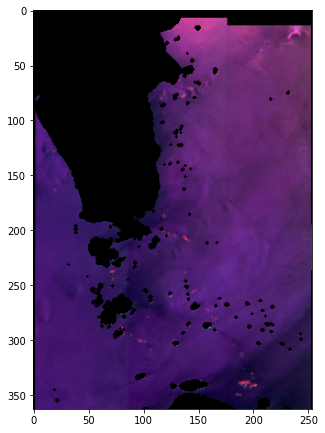

Image: SAR_swath_images_VV+VH+WS/category2/2019-06-13 01_11_16.png label: 1


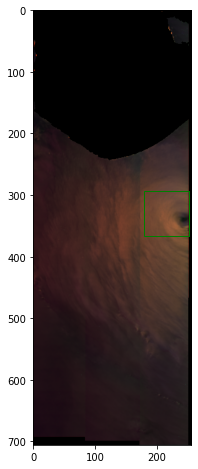

Image: SAR_swath_images_VV+VH+WS/category2/2019-11-09 12_12_29.png label: 1


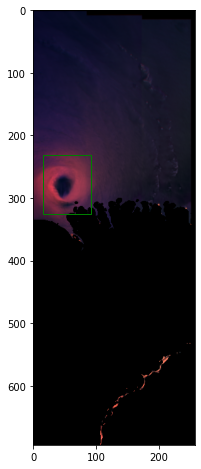

Image: SAR_swath_images_VV+VH+WS/category2/2019-12-01 21_23_30.png label: 0


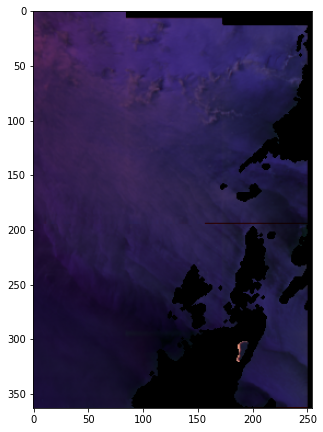

Image: SAR_swath_images_VV+VH+WS/category2/2019-12-08 15_28_32.png label: 0


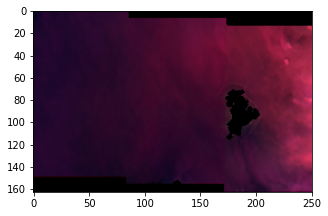

Image: SAR_swath_images_VV+VH+WS/category2/2018-07-27 08_22_40.png label: 1


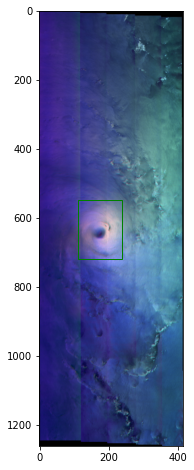

Image: SAR_swath_images_VV+VH+WS/category2/2018-07-27 20_27_30.png label: 1


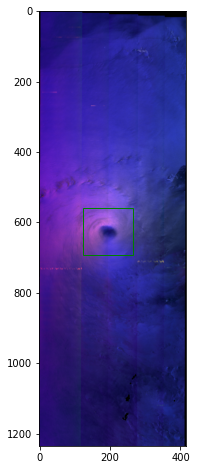

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-01 13_56_09.png label: 0


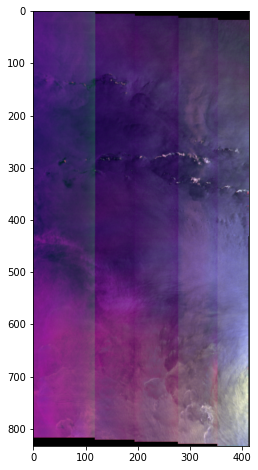

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-02 02_26_10.png label: 1


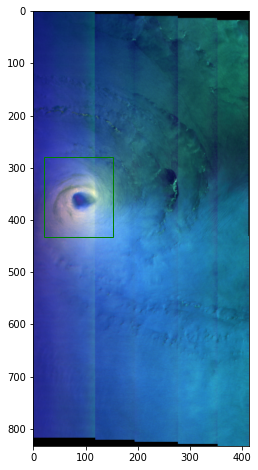

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-30 01_54_11.png label: 1


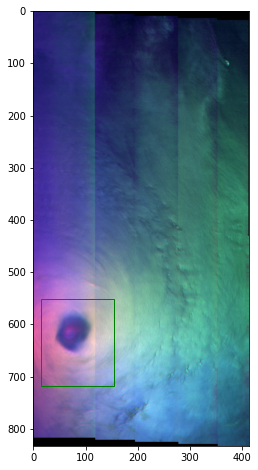

Image: SAR_swath_images_VV+VH+WS/category2/2019-06-12 01_18_27.png label: 1


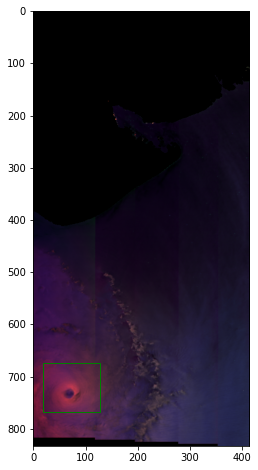

Image: SAR_swath_images_VV+VH+WS/category2/2019-10-30 01_52_30.png label: 1


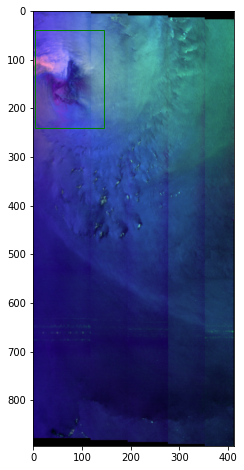

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-13 23_13_32.png label: 0


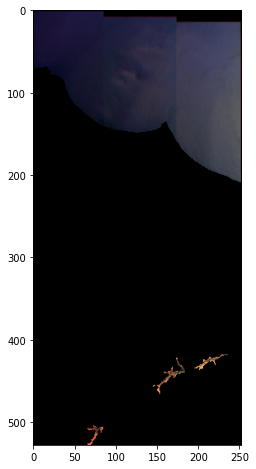

Image: SAR_swath_images_VV+VH+WS/category2/2018-09-29 09_28_26.png label: 1


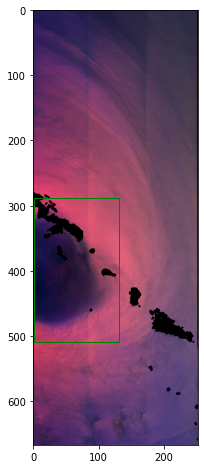

Image: SAR_swath_images_VV+VH+WS/category2/2018-10-10 23_36_59.png label: 0


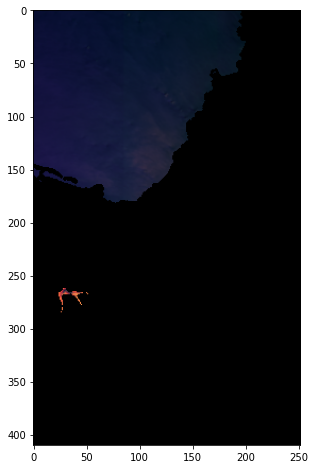

Image: SAR_swath_images_VV+VH+WS/category2/2019-09-04 11_08_44.png label: 0


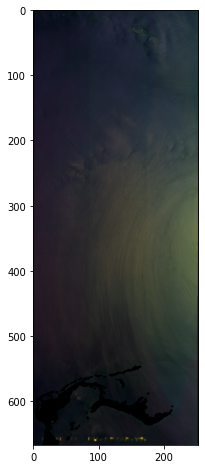

Image: SAR_swath_images_VV+VH+WS/category2/2019-12-08 02_25_21.png label: 1


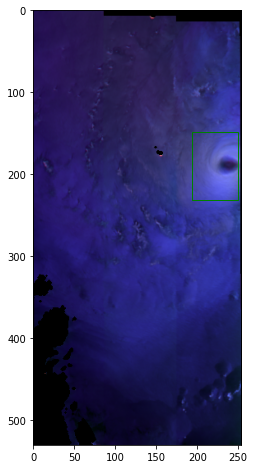

Image: SAR_swath_images_VV+VH+WS/category2/2020-09-06 09_29_00.png label: 0


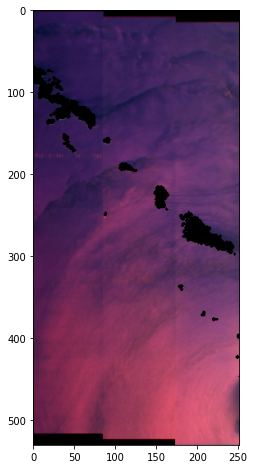

Image: SAR_swath_images_VV+VH+WS/category2/2020-10-07 11_36_02.png label: 0


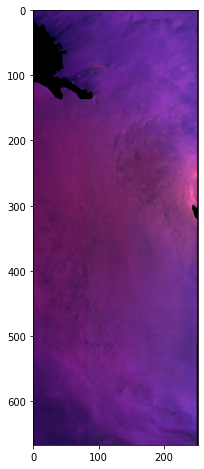

Image: SAR_swath_images_VV+VH+WS/category3/2016-08-25 21_10_21.png label: 0


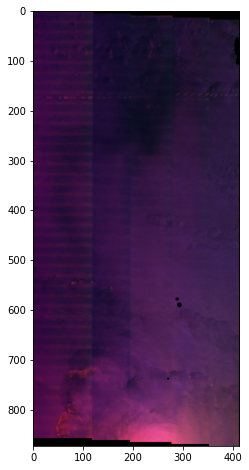

Image: SAR_swath_images_VV+VH+WS/category3/2016-08-27 20_53_26.png label: 1


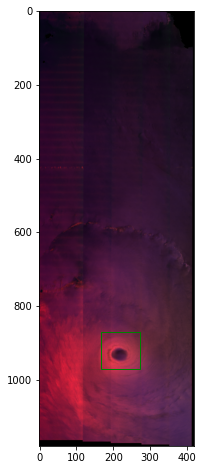

Image: SAR_swath_images_VV+VH+WS/category3/2016-08-30 14_46_05.png label: 1


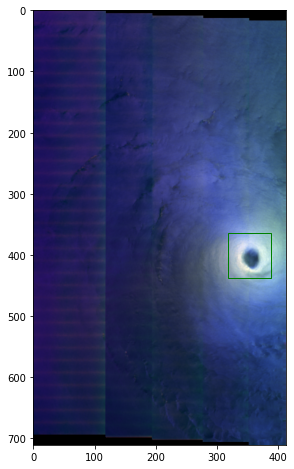

Image: SAR_swath_images_VV+VH+WS/category3/2017-10-14 07_50_32.png label: 0


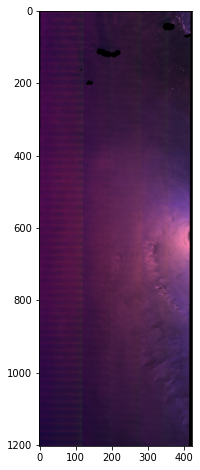

Image: SAR_swath_images_VV+VH+WS/category3/2018-08-20 09_12_58.png label: 0


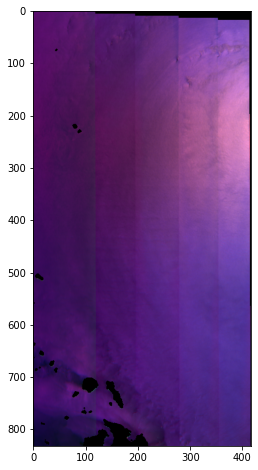

Image: SAR_swath_images_VV+VH+WS/category3/2018-09-05 02_02_06.png label: 1


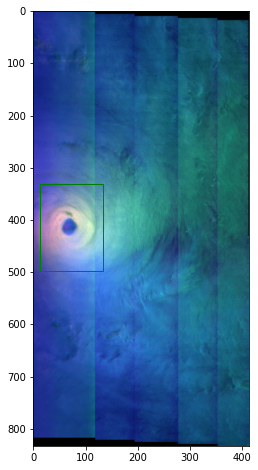

Image: SAR_swath_images_VV+VH+WS/category3/2018-10-03 13_41_08.png label: 1


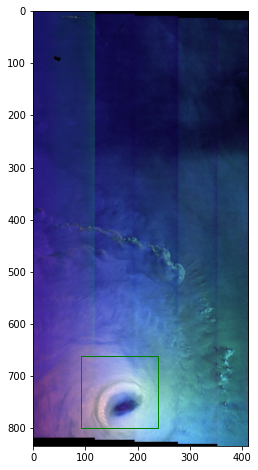

Image: SAR_swath_images_VV+VH+WS/category3/2018-10-06 14_05_58.png label: 1


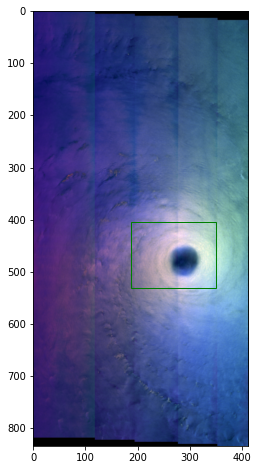

Image: SAR_swath_images_VV+VH+WS/category3/2018-10-07 02_35_07.png label: 1


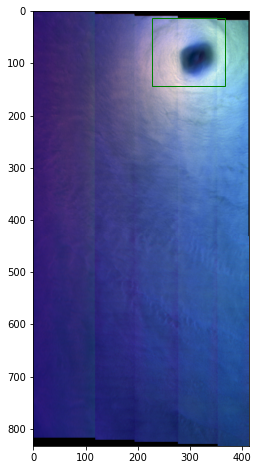

Image: SAR_swath_images_VV+VH+WS/category3/2018-10-09 23_44_37.png label: 1


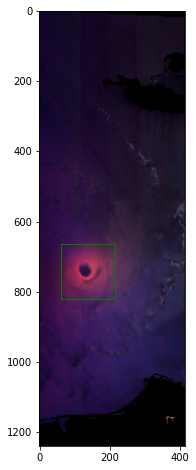

Image: SAR_swath_images_VV+VH+WS/category3/2019-02-09 01_53_36.png label: 0


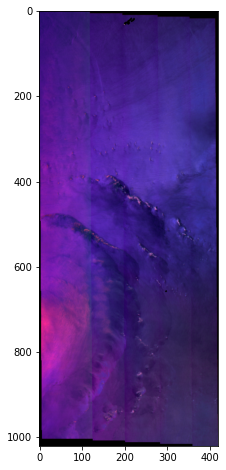

Image: SAR_swath_images_VV+VH+WS/category3/2019-02-22 08_18_03.png label: 0


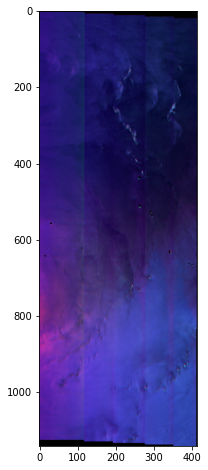

Image: SAR_swath_images_VV+VH+WS/category3/2019-03-26 01_29_48.png label: 0


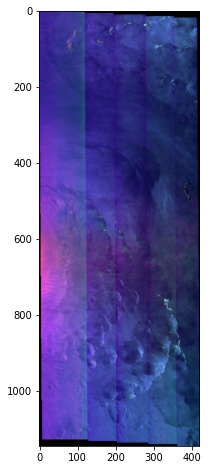

Image: SAR_swath_images_VV+VH+WS/category3/2019-07-31 03_48_15.png label: 1


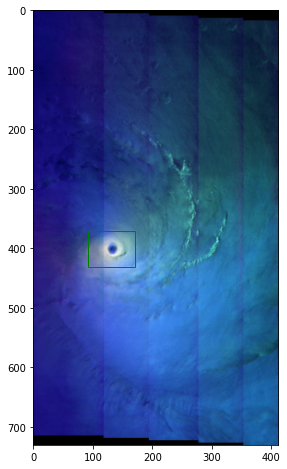

Image: SAR_swath_images_VV+VH+WS/category3/2019-09-28 08_43_41.png label: 0


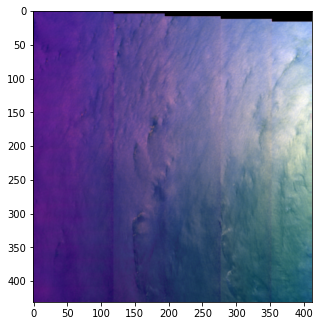

Image: SAR_swath_images_VV+VH+WS/category3/2019-10-11 20_53_32.png label: 1


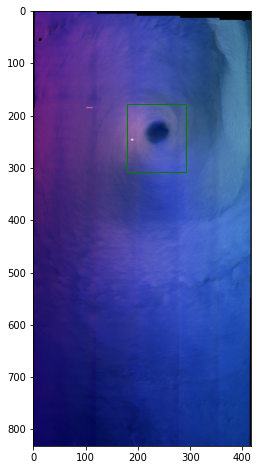

Image: SAR_swath_images_VV+VH+WS/category3/2020-07-25 03_48_58.png label: 1


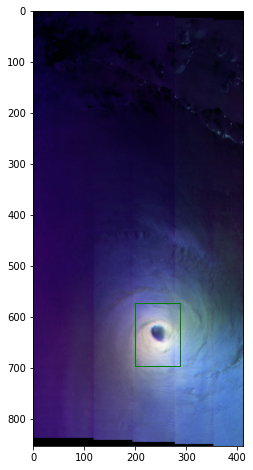

Image: SAR_swath_images_VV+VH+WS/category3/2020-10-26 22_12_04.png label: 1


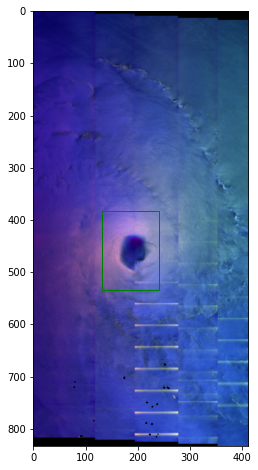

Image: SAR_swath_images_VV+VH+WS/category3/2020-10-27 10_39_49.png label: 1


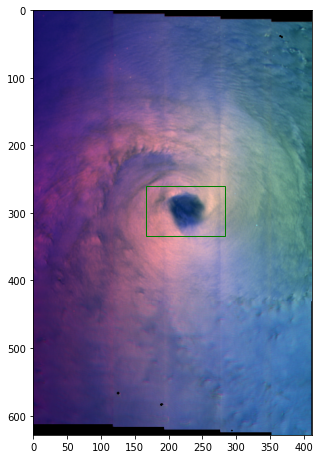

Image: SAR_swath_images_VV+VH+WS/category3/2016-09-17 10_01_21.png label: 0


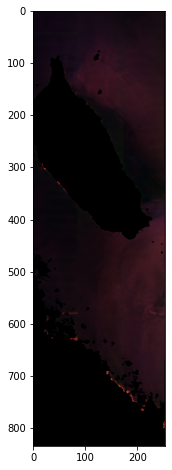

Image: SAR_swath_images_VV+VH+WS/category3/2016-09-26 21_44_21.png label: 1


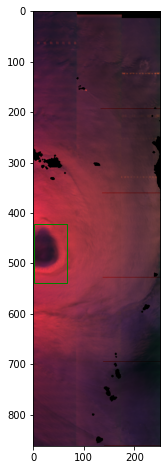

Image: SAR_swath_images_VV+VH+WS/category3/2017-09-21 22_45_23.png label: 1


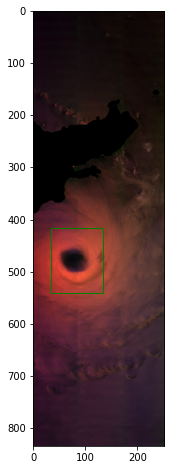

Image: SAR_swath_images_VV+VH+WS/category3/2019-03-14 03_09_05.png label: 0


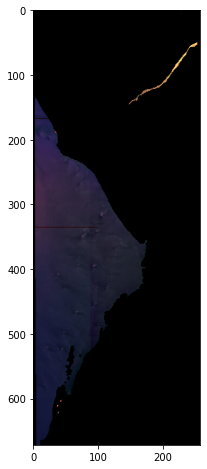

Image: SAR_swath_images_VV+VH+WS/category3/2019-05-02 00_22_48.png label: 0


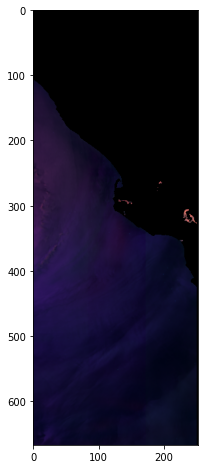

Image: SAR_swath_images_VV+VH+WS/category3/2019-08-09 10_02_13.png label: 0


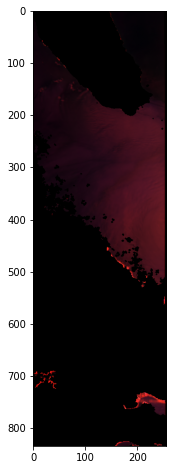

Image: SAR_swath_images_VV+VH+WS/category3/2019-08-30 22_46_26.png label: 1


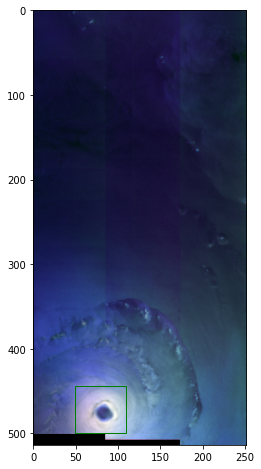

Image: SAR_swath_images_VV+VH+WS/category3/2019-09-03 11_18_11.png label: 0


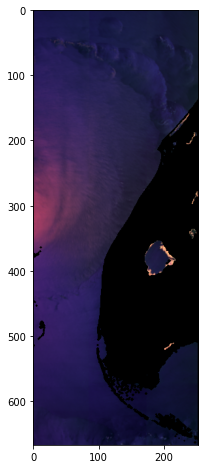

Image: SAR_swath_images_VV+VH+WS/category3/2020-10-09 12_07_34.png label: 0


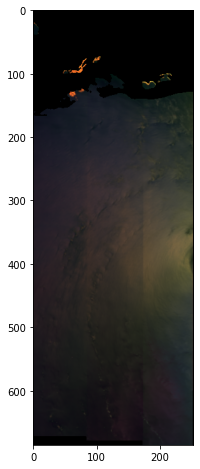

Image: SAR_swath_images_VV+VH+WS/category3/2020-11-03 23_41_36.png label: 0


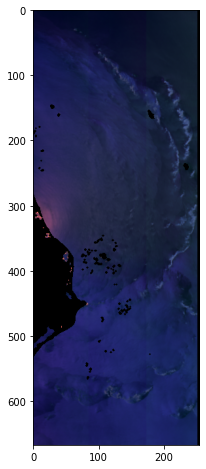

Image: SAR_swath_images_VV+VH+WS/category3/2018-02-02 13_14_40.png label: 0


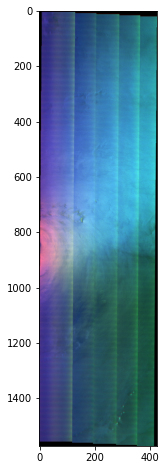

Image: SAR_swath_images_VV+VH+WS/category3/2018-08-04 14_30_09.png label: 0


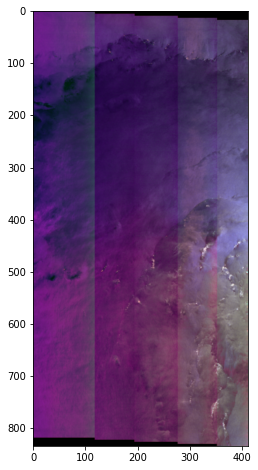

Image: SAR_swath_images_VV+VH+WS/category3/2018-08-11 05_27_33.png label: 1


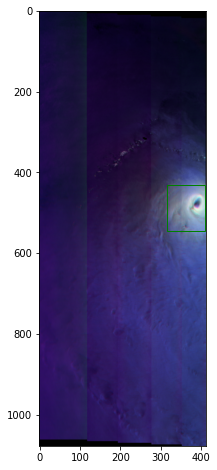

Image: SAR_swath_images_VV+VH+WS/category3/2018-08-18 08_38_29.png label: 1


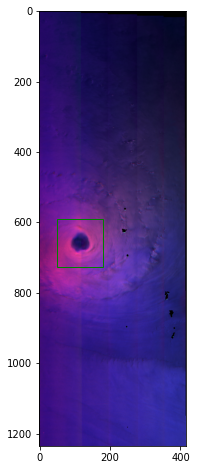

Image: SAR_swath_images_VV+VH+WS/category3/2018-08-18 20_45_31.png label: 1


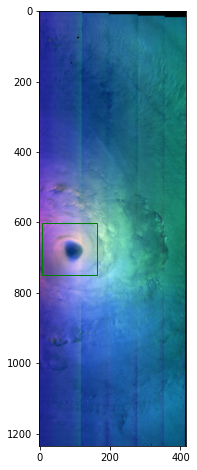

Image: SAR_swath_images_VV+VH+WS/category3/2018-09-07 02_35_10.png label: 0


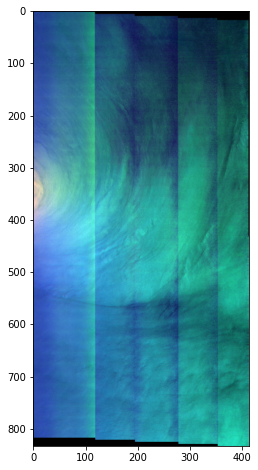

Image: SAR_swath_images_VV+VH+WS/category3/2018-10-05 02_00_42.png label: 1


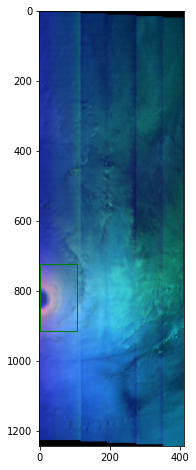

Image: SAR_swath_images_VV+VH+WS/category3/2019-02-24 08_51_14.png label: 0


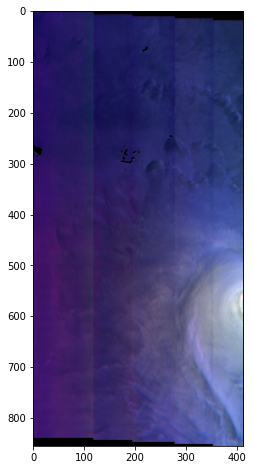

Image: SAR_swath_images_VV+VH+WS/category3/2019-02-26 08_36_13.png label: 0


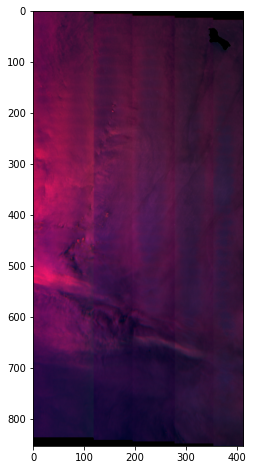

Image: SAR_swath_images_VV+VH+WS/category3/2019-03-23 10_46_25.png label: 1


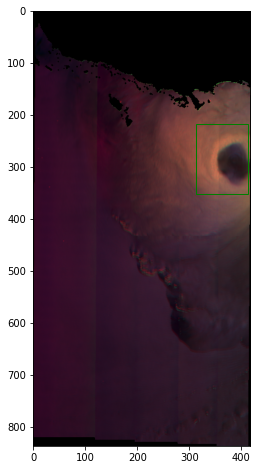

Image: SAR_swath_images_VV+VH+WS/category3/2019-07-04 02_33_33.png label: 1


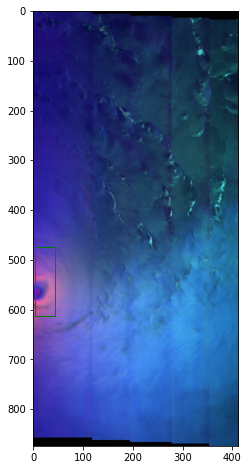

Image: SAR_swath_images_VV+VH+WS/category3/2019-09-29 21_07_12.png label: 0


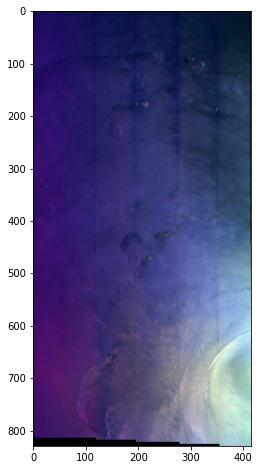

Image: SAR_swath_images_VV+VH+WS/category3/2020-09-01 21_26_24.png label: 0


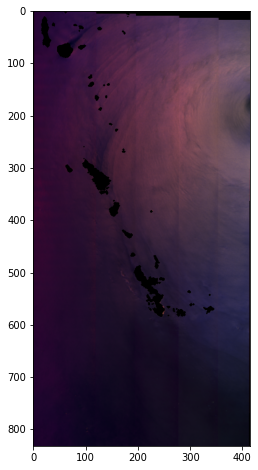

Image: SAR_swath_images_VV+VH+WS/category3/2020-11-14 10_39_19.png label: 0


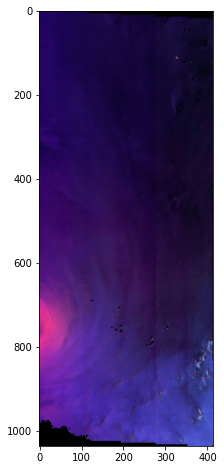

Image: SAR_swath_images_VV+VH+WS/category3/2017-05-08 18_22_05.png label: 0


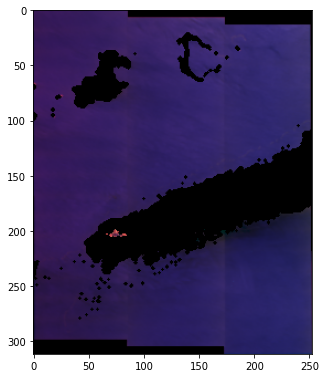

Image: SAR_swath_images_VV+VH+WS/category3/2017-09-09 23_34_59.png label: 0


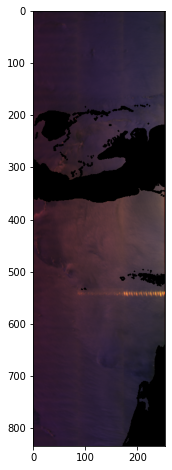

Image: SAR_swath_images_VV+VH+WS/category3/2017-09-23 10_44_51.png label: 1


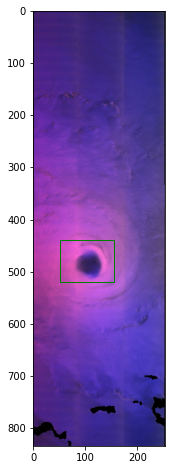

Image: SAR_swath_images_VV+VH+WS/category3/2017-10-14 19_39_43.png label: 1


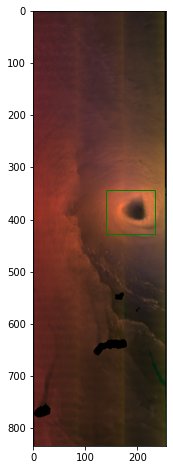

Image: SAR_swath_images_VV+VH+WS/category3/2018-08-24 04_29_50.png label: 0


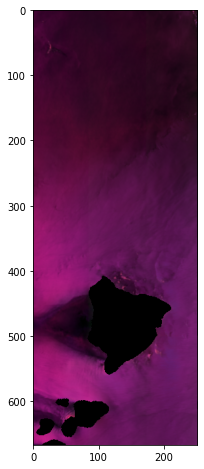

Image: SAR_swath_images_VV+VH+WS/category3/2019-03-14 16_06_56.png label: 1


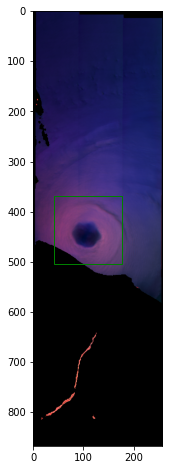

Image: SAR_swath_images_VV+VH+WS/category3/2019-03-23 21_39_25.png label: 1


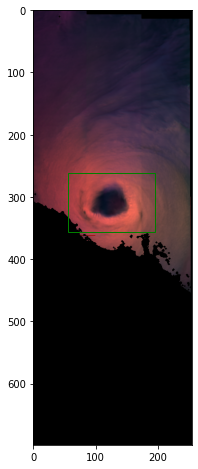

Image: SAR_swath_images_VV+VH+WS/category3/2020-08-25 21_32_49.png label: 0


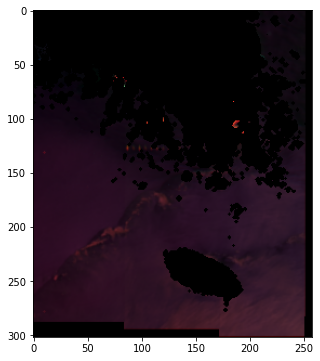

Image: SAR_swath_images_VV+VH+WS/category4/2016-08-31 03_16_16.png label: 1


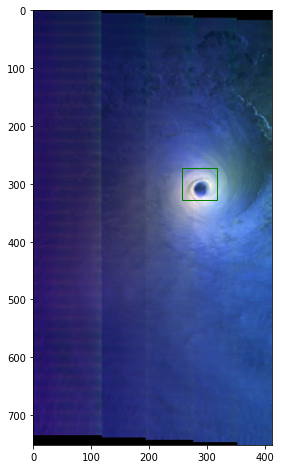

Image: SAR_swath_images_VV+VH+WS/category4/2016-10-02 11_04_43.png label: 0


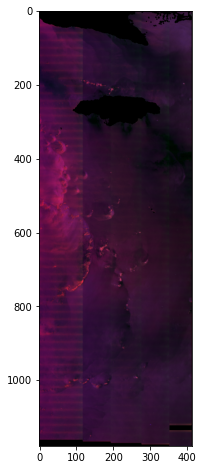

Image: SAR_swath_images_VV+VH+WS/category4/2018-02-01 13_23_53.png label: 1


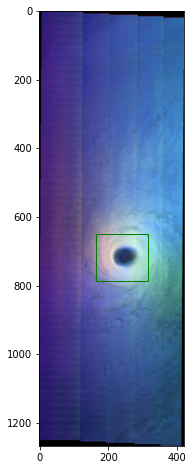

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-07 15_44_04.png label: 1


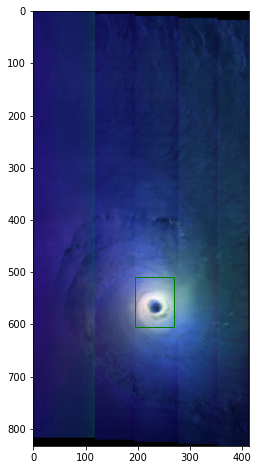

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-08 04_14_05.png label: 1


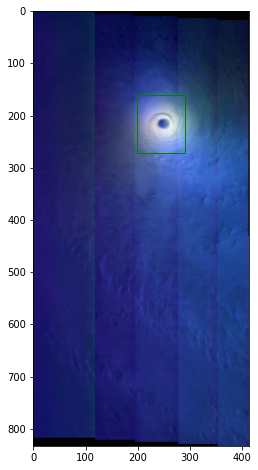

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-18 15_04_32.png label: 1


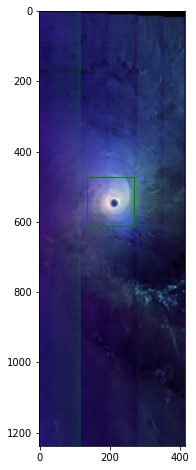

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-19 03_31_31.png label: 1


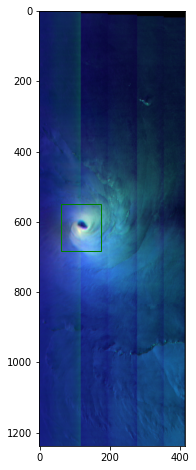

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-31 01_54_06.png label: 0


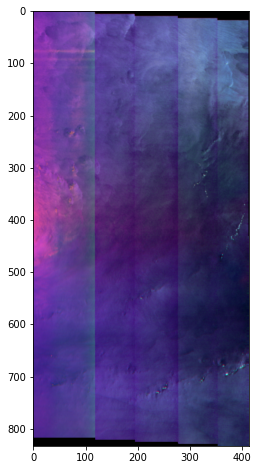

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-31 14_05_05.png label: 0


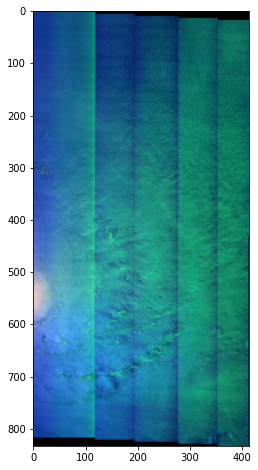

Image: SAR_swath_images_VV+VH+WS/category4/2018-09-25 21_20_38.png label: 1


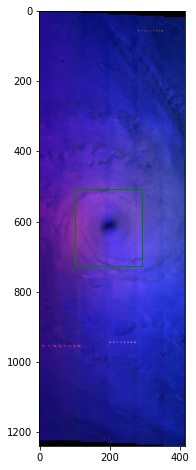

Image: SAR_swath_images_VV+VH+WS/category4/2018-09-28 13_33_09.png label: 0


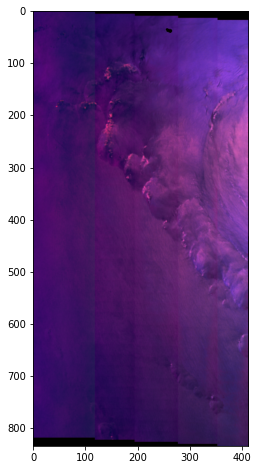

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-02 21_12_08.png label: 1


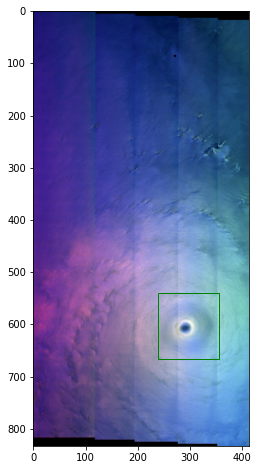

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-04 02_10_08.png label: 1


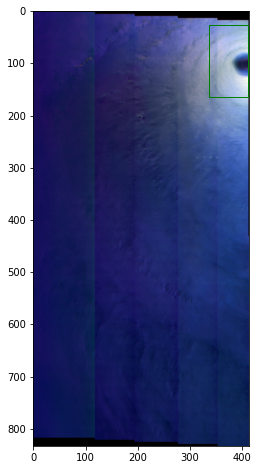

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-10 11_50_39.png label: 1


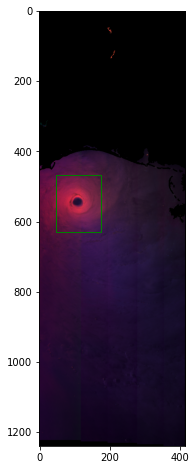

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-25 20_32_21.png label: 1


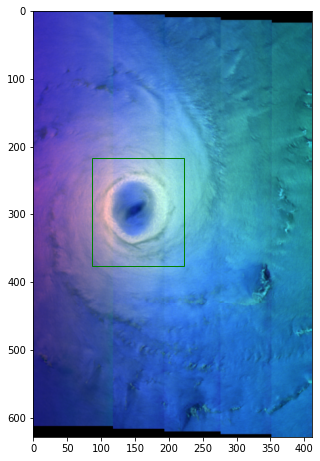

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-26 09_01_52.png label: 1


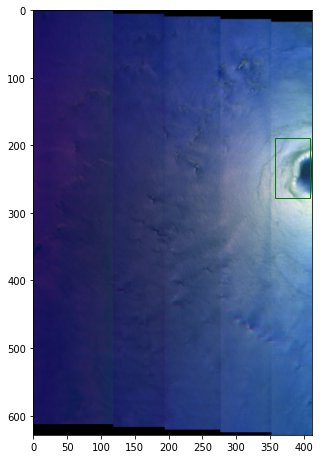

Image: SAR_swath_images_VV+VH+WS/category4/2019-02-24 20_17_23.png label: 0


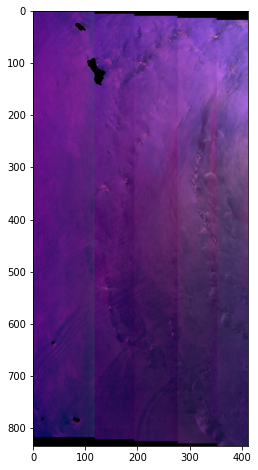

Image: SAR_swath_images_VV+VH+WS/category4/2019-03-28 01_13_54.png label: 0


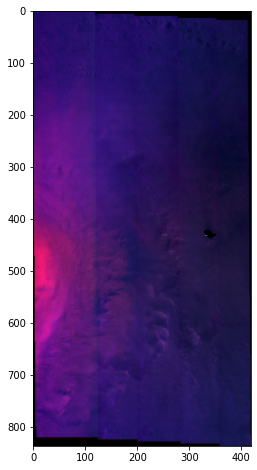

Image: SAR_swath_images_VV+VH+WS/category4/2019-10-22 20_15_43.png label: 0


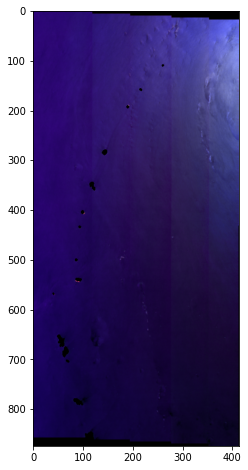

Image: SAR_swath_images_VV+VH+WS/category4/2020-09-04 21_03_32.png label: 1


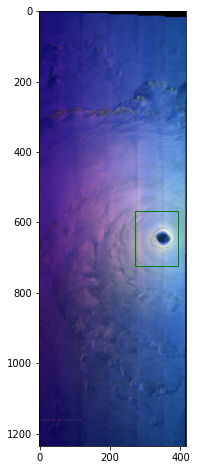

Image: SAR_swath_images_VV+VH+WS/category4/2020-10-02 13_57_56.png label: 0


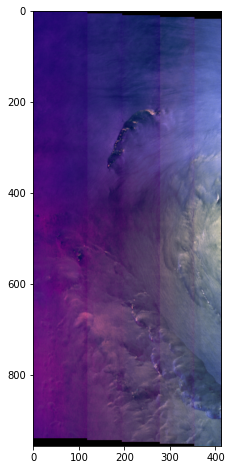

Image: SAR_swath_images_VV+VH+WS/category4/2020-10-03 02_27_08.png label: 1


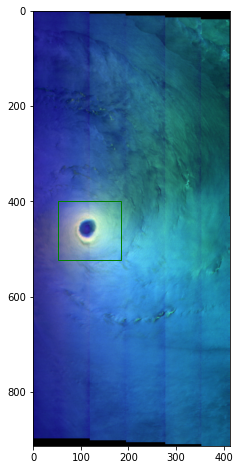

Image: SAR_swath_images_VV+VH+WS/category4/2020-10-29 20_57_14.png label: 1


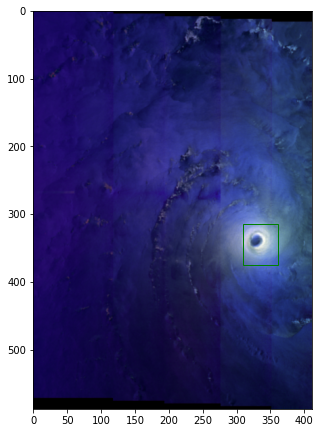

Image: SAR_swath_images_VV+VH+WS/category4/2017-09-08 22_03_19.png label: 1


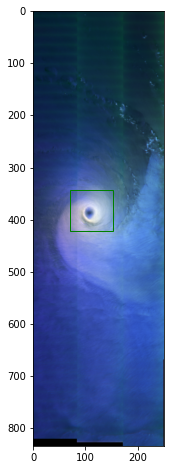

Image: SAR_swath_images_VV+VH+WS/category4/2017-09-18 22_19_14.png label: 0


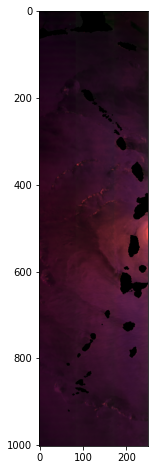

Image: SAR_swath_images_VV+VH+WS/category4/2018-02-12 06_07_04.png label: 0


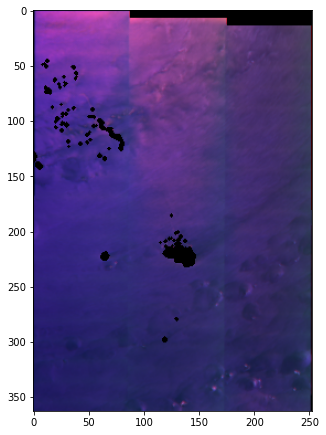

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-23 04_38_08.png label: 1


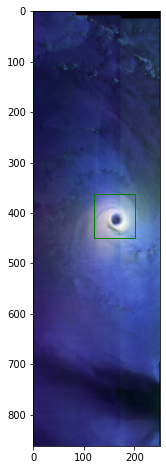

Image: SAR_swath_images_VV+VH+WS/category4/2019-08-31 10_54_08.png label: 0


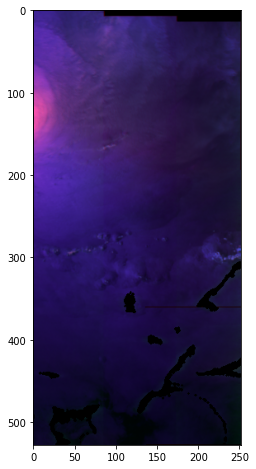

Image: SAR_swath_images_VV+VH+WS/category4/2019-09-02 23_12_03.png label: 0


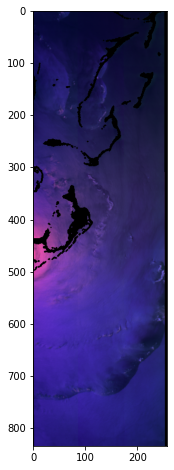

Image: SAR_swath_images_VV+VH+WS/category4/2020-08-27 00_10_23.png label: 1


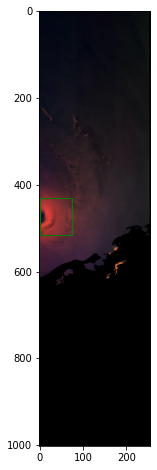

Image: SAR_swath_images_VV+VH+WS/category4/2018-01-31 13_31_29.png label: 0


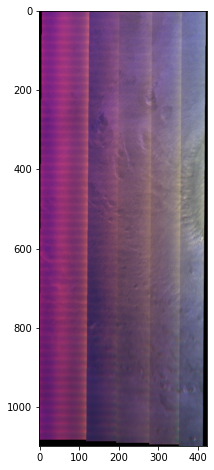

Image: SAR_swath_images_VV+VH+WS/category4/2018-02-01 00_22_52.png label: 1


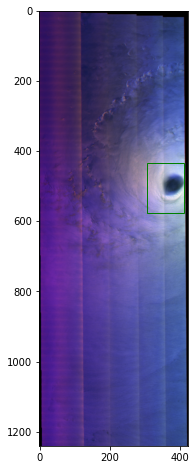

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-06 03_39_09.png label: 0


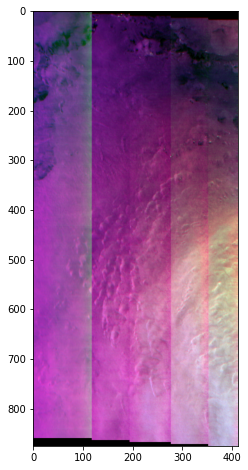

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-10 04_46_07.png label: 0


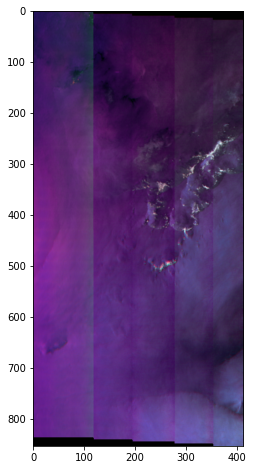

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-10 16_57_14.png label: 1


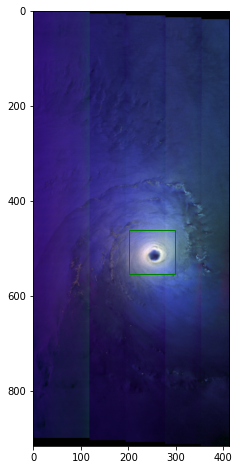

Image: SAR_swath_images_VV+VH+WS/category4/2018-08-20 15_35_38.png label: 0


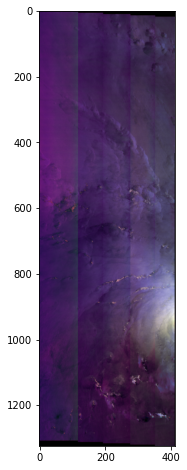

Image: SAR_swath_images_VV+VH+WS/category4/2018-09-02 14_38_10.png label: 1


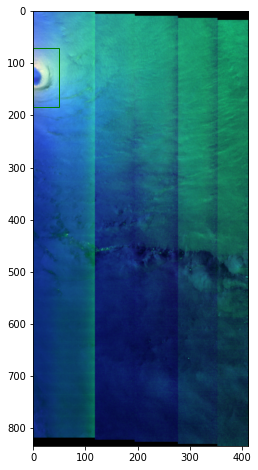

Image: SAR_swath_images_VV+VH+WS/category4/2018-09-03 03_07_10.png label: 0


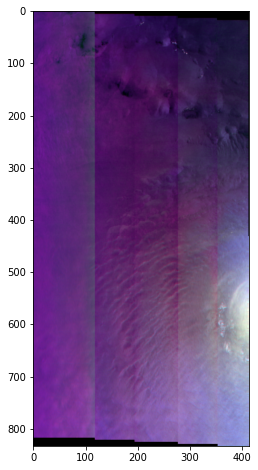

Image: SAR_swath_images_VV+VH+WS/category4/2018-09-05 20_58_11.png label: 0


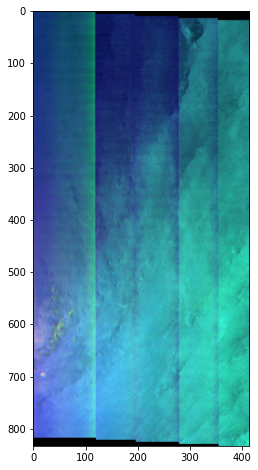

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-03 05_35_41.png label: 1


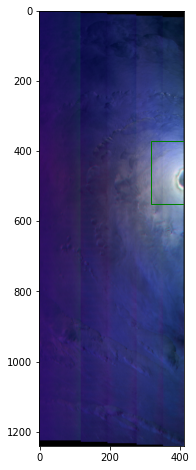

Image: SAR_swath_images_VV+VH+WS/category4/2018-10-27 21_03_55.png label: 1


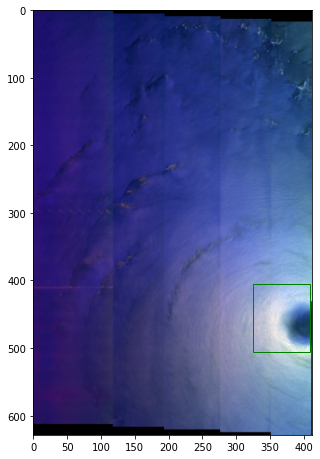

Image: SAR_swath_images_VV+VH+WS/category4/2019-02-23 20_24_50.png label: 1


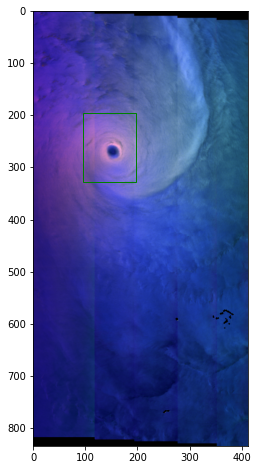

Image: SAR_swath_images_VV+VH+WS/category4/2019-05-03 00_13_57.png label: 1


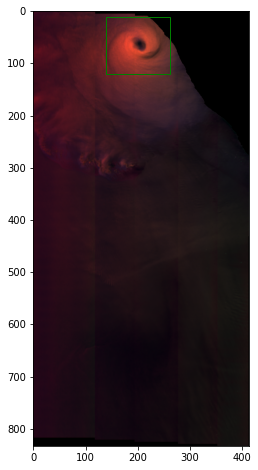

Image: SAR_swath_images_VV+VH+WS/category4/2019-09-26 20_40_04.png label: 0


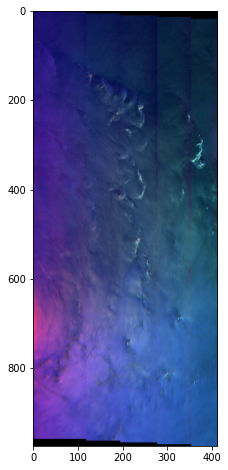

Image: SAR_swath_images_VV+VH+WS/category4/2019-10-10 08_54_02.png label: 0


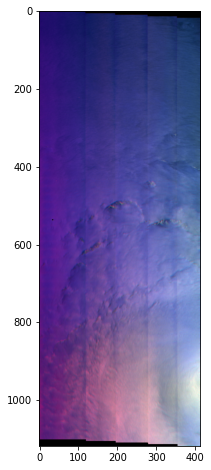

Image: SAR_swath_images_VV+VH+WS/category4/2019-11-06 19_49_05.png label: 1


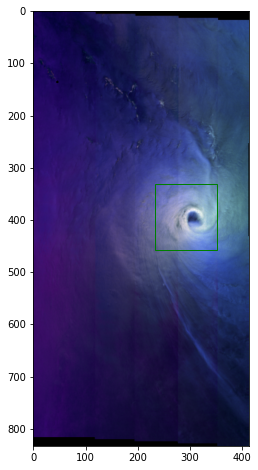

Image: SAR_swath_images_VV+VH+WS/category4/2016-09-30 22_58_38.png label: 0


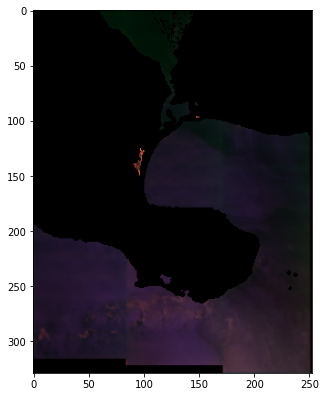

Image: SAR_swath_images_VV+VH+WS/category4/2017-09-09 11_02_15.png label: 0


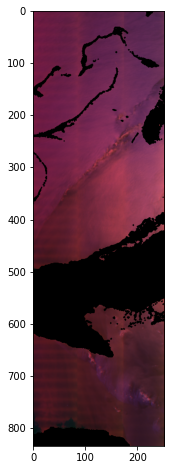

Image: SAR_swath_images_VV+VH+WS/category4/2017-09-20 10_22_16.png label: 0


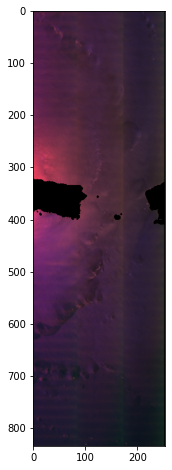

Image: SAR_swath_images_VV+VH+WS/category4/2019-09-05 09_36_33.png label: 0


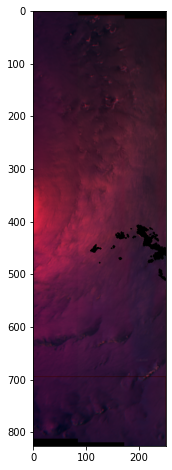

Image: SAR_swath_images_VV+VH+WS/category4/2019-09-05 21_42_33.png label: 0


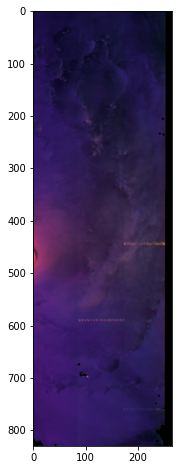

Image: SAR_swath_images_VV+VH+WS/category5/2018-08-30 19_58_36.png label: 0


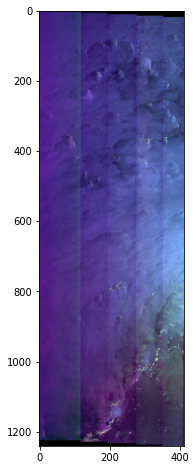

Image: SAR_swath_images_VV+VH+WS/category5/2018-08-31 08_29_35.png label: 0


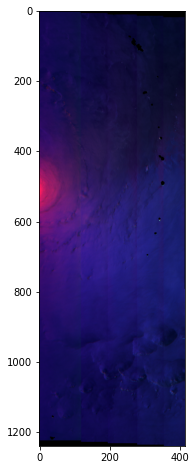

Image: SAR_swath_images_VV+VH+WS/category5/2018-08-31 20_39_05.png label: 1


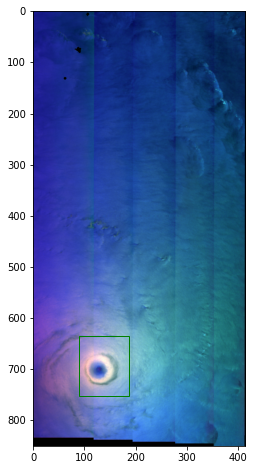

Image: SAR_swath_images_VV+VH+WS/category5/2018-09-14 09_51_28.png label: 1


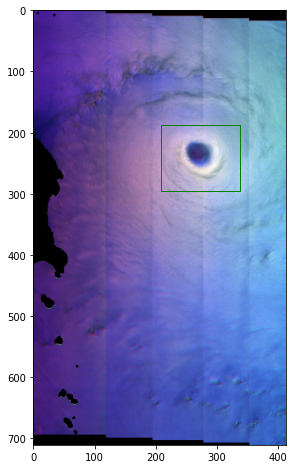

Image: SAR_swath_images_VV+VH+WS/category5/2019-10-08 20_31_45.png label: 1


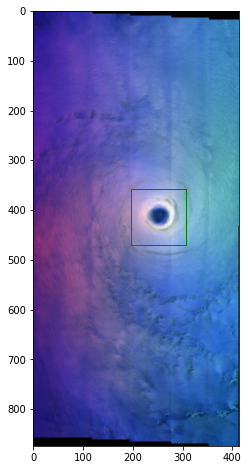

Image: SAR_swath_images_VV+VH+WS/category5/2019-11-05 19_58_23.png label: 1


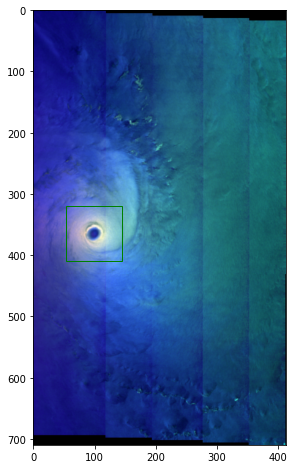

Image: SAR_swath_images_VV+VH+WS/category5/2020-10-30 09_26_25.png label: 1


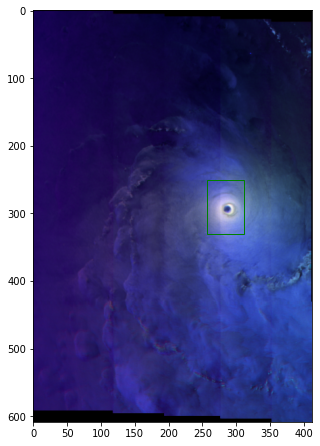

Image: SAR_swath_images_VV+VH+WS/category5/2017-09-06 22_20_28.png label: 0


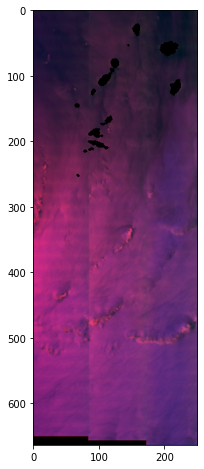

Image: SAR_swath_images_VV+VH+WS/category5/2017-09-07 10_30_39.png label: 1


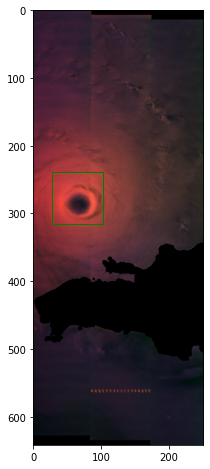

Image: SAR_swath_images_VV+VH+WS/category5/2017-09-07 23_01_56.png label: 0


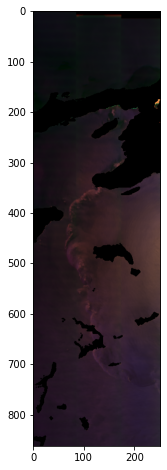

Image: SAR_swath_images_VV+VH+WS/category5/2020-04-06 07_13_52.png label: 1


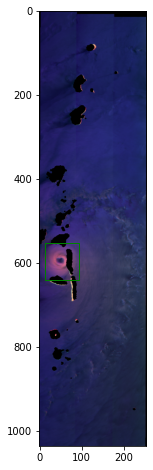

Image: SAR_swath_images_VV+VH+WS/category5/2018-09-11 20_48_44.png label: 1


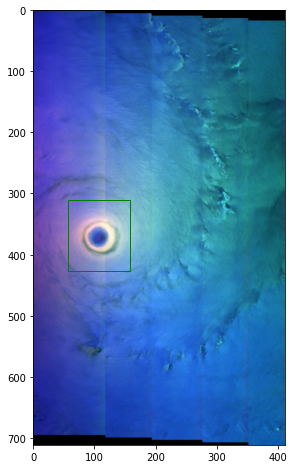

Image: SAR_swath_images_VV+VH+WS/category5/2020-10-31 21_30_13.png label: 1


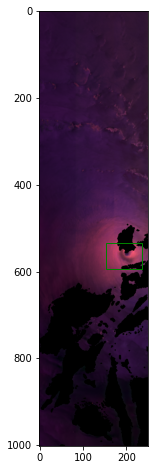

In [ ]:
import matplotlib
df = pd.read_csv('SAR_swath_images_VV+VH+WS/csv2/full_dataset.csv', converters={'bbox_shape': eval})

for idx, row in df.iterrows():
  print("Image:", df['image'][idx], "label:", df['label'][idx])
  img = cv2.imread(df['image'][idx])

  b = img/np.max(img)
  fig, ax = plt.subplots(figsize=(5,8))
  plt.imshow(b)

  if df['bbox_shape'][idx] != []:
    bbox = df['bbox_shape'][idx]

    # read dimensions of bbox_eye
    cX = (int)(bbox[0])
    cY = (int)(bbox[1])
    bb_width = (int)(bbox[2])
    bb_height = (int)(bbox[3])

    ax.add_patch(matplotlib.patches.Rectangle((cX, cY), bb_width, bb_height, color ='green', fc='none'))
  plt.show()